# Similarity between Dialogues

## Visualizing Clusters

Функции близости основаны на DGAC кластеризации, поэтому сперва нужно посмотреть, хорошо ли прошла кластеризация реплик диалогов.

In [1]:
from visualization_utils import show_clusters
from dgac_clustering import Clusters


show_clusters(is_system=False)
show_clusters(is_system=True)

## Count Vectorizer over Cluster Labels

Использует ранее созданные файлы

In [1]:
from similarity_functions import count_vectorizer_from_sile_system as cv
from dgac_clustering import Clusters


cv(['listwise_shuffler', 'original'])

/home/alekseev_ilya/dialogue-augmentation/VENV/lib/python3.8/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
Batches: 100%|██████████| 8/8 [00:00<00:00, 58.54it/s]


## Визуально оценить качество полученных диалогов

### EDA

In [6]:
for name in ['eda1', 'eda3', 'eda5']:
    print(name, ' '.join([f'{a:.2f}' for a in compute_similarities(name, dice)]))

eda1 1.00 0.85 1.00 1.00 0.90 0.92 0.88 0.88 0.86 0.94 0.85 1.00 0.78 1.00 0.89
eda3 0.92 0.75 0.83 0.92 0.90 0.92 0.88 0.94 0.89 0.94 0.88 1.00 0.78 0.92 0.89
eda5 0.67 0.50 0.67 0.75 0.80 0.67 1.00 0.81 0.82 0.81 0.73 0.88 0.67 0.92 0.78


In [8]:
from visualization_utils import show_similarities


for name in ['eda1', 'eda3', 'eda5']:
    print(f'======= {name} =======')
    show_similarities(0, name, dice)

======= eda1 =======
similarity: 1.0


[A] [label: 0] [name: food, looking, restaurant] <span style='color:green;font-weight:700;'>looking </span>I'm <span style='color:red;font-weight:700;text-decoration:line-through;'>looking </span>for a local place to dine in the centre that serves chinese food. 

[B] [label: 15] [name: food, like, restaurants] I have restaurants matching your criteria in all price <span style='color:red;font-weight:700;text-decoration:line-through;'>ranges. </span><span style='color:green;font-weight:700;'>crop. </span>Do you have a preference on price? 

[A] [label: 1] [name: address, phone, postcode] I <span style='color:green;font-weight:700;'>orbit </span>need the address, postcode and the price range. 

[B] [label: 16] [name: book, like, time] Ok how about Charlie Chan, <span style='color:red;font-weight:700;text-decoration:line-through;'>located </span><span style='color:green;font-weight:700;'>situate </span>at Regent Street City Centre. Postcode is cb21db with a cheap <span style='color:red;font-weight:700;text-decoration:line-through;'>price. </span><span style='color:green;font-weight:700;'>damage. </span>Can I help you further today? 

[A] [label: 9] [name: cambridge, need, train] I also need a train. The train should leave <span style='color:green;font-weight:700;'>axerophthol </span>after 16:15 and should leave on sunday. 

[B] [label: 24] [name: booking, number, reference] <span style='color:red;font-weight:700;text-decoration:line-through;'>Can </span><span style='color:green;font-weight:700;'>canful </span>I have more information for the train you're needing? Where are you departing from and arriving to? 

[A] [label: 5] [name: cambridge, leaving, need] I am leaving from Cambridge and going to Norwich. 

[B] [label: 20] [name: address, number, phone] I have train TR1840 <span style='color:red;font-weight:700;text-decoration:line-through;'>leaving </span><span style='color:green;font-weight:700;'>that </span>at 16:36 is <span style='color:red;font-weight:700;text-decoration:line-through;'>that </span><span style='color:green;font-weight:700;'>leaving </span>okay? 

[A] [label: 3] [name: book, people, yes] book <span style='color:green;font-weight:700;'>enumerate </span>for 5 people and get me the reference number 

[B] [label: 18] [name: leaves, like, train] You're all set. Reference number is <span style='color:red;font-weight:700;text-decoration:line-through;'>NJB87PAP </span>. Is there anything else I can help you with today? 

[A] [label: 2] [name: help, thank, thanks] No, this is all I <span style='color:red;font-weight:700;text-decoration:line-through;'>will need. </span><span style='color:green;font-weight:700;'>will. </span>Thank you. 

[B] [label: 17] [name: goodbye, thank, using] Thank for calling us today. <span style='color:red;font-weight:700;text-decoration:line-through;'>I </span>hope you have a good trip.

======= eda3 =======
similarity: 0.9166666666666666


[A] [label: 0] [name: food, looking, restaurant] <span style='color:red;font-weight:700;text-decoration:line-through;'>I'm looking </span><span style='color:green;font-weight:700;'>serves the </span>for a local place to dine in <span style='color:red;font-weight:700;text-decoration:line-through;'>the </span><span style='color:green;font-weight:700;'>looking </span>centre that <span style='color:red;font-weight:700;text-decoration:line-through;'>serves </span><span style='color:green;font-weight:700;'>I'm </span>chinese food. 

[B] [label: 15] [name: food, like, restaurants] <span style='color:red;font-weight:700;text-decoration:line-through;'>I have </span>restaurants matching <span style='color:red;font-weight:700;text-decoration:line-through;'>your </span>criteria in all price ranges. Do you have a <span style='color:red;font-weight:700;text-decoration:line-through;'>preference on price? </span><span style='color:green;font-weight:700;'>on? </span>

[A] [label: 1] [name: address, phone, postcode] I <span style='color:red;font-weight:700;text-decoration:line-through;'>need </span>the address, <span style='color:red;font-weight:700;text-decoration:line-through;'>postcode </span>and the price range. 

[B] [label: 16] [name: book, like, time] <span style='color:red;font-weight:700;text-decoration:line-through;'>Ok </span><span style='color:green;font-weight:700;'>fine </span>how about Charlie Chan, <span style='color:red;font-weight:700;text-decoration:line-through;'>located </span><span style='color:green;font-weight:700;'>site </span>at Regent Street <span style='color:red;font-weight:700;text-decoration:line-through;'>City Centre. </span><span style='color:green;font-weight:700;'>metropolis essence. </span>Postcode is cb21db with a <span style='color:red;font-weight:700;text-decoration:line-through;'>cheap </span><span style='color:green;font-weight:700;'>flashy </span>price. <span style='color:red;font-weight:700;text-decoration:line-through;'>Can I help </span><span style='color:green;font-weight:700;'>backside I service </span>you further today? 

[A] [label: 9] [name: cambridge, need, train] I also <span style='color:green;font-weight:700;'>angstrom </span>need a train. The train should <span style='color:green;font-weight:700;'>result </span>leave <span style='color:green;font-weight:700;'>XV </span>after 16:15 and should leave on sunday. 

[B] [label: 24] [name: booking, number, reference] Can <span style='color:red;font-weight:700;text-decoration:line-through;'>I </span>have more information <span style='color:red;font-weight:700;text-decoration:line-through;'>for the </span>train you're needing? <span style='color:red;font-weight:700;text-decoration:line-through;'>Where </span>are you departing from and <span style='color:red;font-weight:700;text-decoration:line-through;'>arriving to? </span><span style='color:green;font-weight:700;'>arriving? </span>

[A] [label: 5] [name: cambridge, leaving, need] I am <span style='color:red;font-weight:700;text-decoration:line-through;'>leaving </span><span style='color:green;font-weight:700;'>leave </span>from Cambridge and <span style='color:red;font-weight:700;text-decoration:line-through;'>going </span><span style='color:green;font-weight:700;'>sound </span>to Norwich. 

[B] [label: 20] [name: address, number, phone] <span style='color:green;font-weight:700;'>one </span>I have train TR1840 <span style='color:green;font-weight:700;'>fine </span>leaving at 16:36 is that okay? 

[A] [label: 3] [name: book, people, yes] <span style='color:red;font-weight:700;text-decoration:line-through;'>book </span><span style='color:green;font-weight:700;'>script </span>for <span style='color:red;font-weight:700;text-decoration:line-through;'>5 </span><span style='color:green;font-weight:700;'>V </span>people and <span style='color:red;font-weight:700;text-decoration:line-through;'>get </span><span style='color:green;font-weight:700;'>cause </span>me the reference number 

[B] [label: 18] [name: leaves, like, train] You're all <span style='color:red;font-weight:700;text-decoration:line-through;'>set. Reference </span><span style='color:green;font-weight:700;'>solidification. mention </span>number is NJB87PAP . <span style='color:red;font-weight:700;text-decoration:line-through;'>Is </span><span style='color:green;font-weight:700;'>equal </span>there anything else <span style='color:red;font-weight:700;text-decoration:line-through;'>I </span><span style='color:green;font-weight:700;'>ane </span>can <span style='color:red;font-weight:700;text-decoration:line-through;'>help </span><span style='color:green;font-weight:700;'>serve </span>you with today? 

[A] [label: 2] [name: help, thank, thanks] No, this is <span style='color:green;font-weight:700;'>iodin </span>all I will need. Thank you. 

[B] [label: <span style='color:red;font-weight:700;text-decoration:line-through;'>17] [name: goodbye, thank, using] Thank for </span><span style='color:green;font-weight:700;'>25] [name: help, need, today] </span>calling us today. I hope you have <span style='color:red;font-weight:700;text-decoration:line-through;'>a </span>good trip.

======= eda5 =======
similarity: 0.6666666666666666


[A] [label: 0] [name: food, looking, restaurant] I'm <span style='color:red;font-weight:700;text-decoration:line-through;'>looking </span><span style='color:green;font-weight:700;'>look </span>for a local <span style='color:red;font-weight:700;text-decoration:line-through;'>place </span><span style='color:green;font-weight:700;'>point </span>to dine in the <span style='color:red;font-weight:700;text-decoration:line-through;'>centre </span><span style='color:green;font-weight:700;'>heart </span>that <span style='color:red;font-weight:700;text-decoration:line-through;'>serves chinese food. ¶ [B] [label: 15] [name: food, like, restaurants] </span><span style='color:green;font-weight:700;'>help Taiwanese nutrient. </span>

<span style='color:green;font-weight:700;'>[B] [label: 21] [name: area, price, range] </span>I have <span style='color:red;font-weight:700;text-decoration:line-through;'>restaurants matching your </span>criteria in <span style='color:red;font-weight:700;text-decoration:line-through;'>all price ranges. </span><span style='color:green;font-weight:700;'>price. </span>Do you <span style='color:red;font-weight:700;text-decoration:line-through;'>have a </span>preference <span style='color:red;font-weight:700;text-decoration:line-through;'>on price? ¶ [A] [label: 1] [name: </span><span style='color:green;font-weight:700;'>on? </span>

<span style='color:green;font-weight:700;'>[A] [label: 12] [name: price, time, travel] I need </span>address, <span style='color:red;font-weight:700;text-decoration:line-through;'>phone, postcode] I need </span>the <span style='color:red;font-weight:700;text-decoration:line-through;'>address, postcode and the price </span>range. 

[B] [label: 16] [name: book, like, time] <span style='color:red;font-weight:700;text-decoration:line-through;'>Ok how </span><span style='color:green;font-weight:700;'>is Regent </span>about Charlie Chan, <span style='color:red;font-weight:700;text-decoration:line-through;'>located </span><span style='color:green;font-weight:700;'>help </span>at <span style='color:red;font-weight:700;text-decoration:line-through;'>Regent </span><span style='color:green;font-weight:700;'>how </span>Street City Centre. <span style='color:green;font-weight:700;'>I </span>Postcode <span style='color:red;font-weight:700;text-decoration:line-through;'>is </span>cb21db <span style='color:green;font-weight:700;'>cheap a </span>with <span style='color:red;font-weight:700;text-decoration:line-through;'>a cheap </span>price. <span style='color:green;font-weight:700;'>further Ok located you </span>Can <span style='color:red;font-weight:700;text-decoration:line-through;'>I help you further </span>today? 

[A] [label: <span style='color:red;font-weight:700;text-decoration:line-through;'>9] [name: cambridge, need, train] I also need a train. </span><span style='color:green;font-weight:700;'>11] [name: 15, arrive, leave] I 15 sunday a on. </span>The <span style='color:red;font-weight:700;text-decoration:line-through;'>train </span><span style='color:green;font-weight:700;'>should </span>should leave after <span style='color:red;font-weight:700;text-decoration:line-through;'>16:15 </span><span style='color:green;font-weight:700;'>16:also </span>and <span style='color:red;font-weight:700;text-decoration:line-through;'>should </span><span style='color:green;font-weight:700;'>train </span>leave <span style='color:red;font-weight:700;text-decoration:line-through;'>on sunday. </span><span style='color:green;font-weight:700;'>train need. </span>

[B] [label: 24] [name: booking, number, reference] <span style='color:red;font-weight:700;text-decoration:line-through;'>Can I </span><span style='color:green;font-weight:700;'>seat iodine </span>have more <span style='color:red;font-weight:700;text-decoration:line-through;'>information </span><span style='color:green;font-weight:700;'>entropy </span>for the <span style='color:red;font-weight:700;text-decoration:line-through;'>train </span><span style='color:green;font-weight:700;'>school </span>you're <span style='color:red;font-weight:700;text-decoration:line-through;'>needing? </span><span style='color:green;font-weight:700;'>demand? </span>Where are you <span style='color:red;font-weight:700;text-decoration:line-through;'>departing </span><span style='color:green;font-weight:700;'>sidetrack </span>from and <span style='color:red;font-weight:700;text-decoration:line-through;'>arriving </span><span style='color:green;font-weight:700;'>arrive </span>to? 

[A] [label: 5] [name: cambridge, leaving, need] <span style='color:red;font-weight:700;text-decoration:line-through;'>I am </span>leaving from <span style='color:red;font-weight:700;text-decoration:line-through;'>Cambridge and </span>going to Norwich. 

[B] [label: <span style='color:red;font-weight:700;text-decoration:line-through;'>20] [name: address, number, phone] I </span><span style='color:green;font-weight:700;'>26] [name: day, great, welcome] one </span>have <span style='color:red;font-weight:700;text-decoration:line-through;'>train </span><span style='color:green;font-weight:700;'>geartrain </span>TR1840 <span style='color:red;font-weight:700;text-decoration:line-through;'>leaving </span><span style='color:green;font-weight:700;'>forget </span>at <span style='color:red;font-weight:700;text-decoration:line-through;'>16:36 </span><span style='color:green;font-weight:700;'>16:thirty-six </span>is that <span style='color:red;font-weight:700;text-decoration:line-through;'>okay? </span><span style='color:green;font-weight:700;'>okeh? </span>

[A] [label: 3] [name: book, people, yes] book <span style='color:red;font-weight:700;text-decoration:line-through;'>for 5 </span>people and get <span style='color:red;font-weight:700;text-decoration:line-through;'>me the </span>reference <span style='color:red;font-weight:700;text-decoration:line-through;'>number </span>

[B] [label: 18] [name: leaves, like, train] You're all <span style='color:red;font-weight:700;text-decoration:line-through;'>set. Reference number </span><span style='color:green;font-weight:700;'>hardened. credit figure </span>is NJB87PAP . <span style='color:red;font-weight:700;text-decoration:line-through;'>Is </span><span style='color:green;font-weight:700;'>live </span>there anything else <span style='color:red;font-weight:700;text-decoration:line-through;'>I </span><span style='color:green;font-weight:700;'>single </span>can <span style='color:red;font-weight:700;text-decoration:line-through;'>help </span><span style='color:green;font-weight:700;'>supporter </span>you with <span style='color:red;font-weight:700;text-decoration:line-through;'>today? </span><span style='color:green;font-weight:700;'>nowadays? </span>

[A] [label: 2] [name: help, thank, thanks] No, this <span style='color:red;font-weight:700;text-decoration:line-through;'>is </span><span style='color:green;font-weight:700;'>I </span>all <span style='color:red;font-weight:700;text-decoration:line-through;'>I </span><span style='color:green;font-weight:700;'>is Thank need. </span>will <span style='color:red;font-weight:700;text-decoration:line-through;'>need. Thank </span>you. 

[B] [label: 17] [name: goodbye, thank, using] Thank <span style='color:green;font-weight:700;'>good calling hope have. I us you today a </span>for <span style='color:red;font-weight:700;text-decoration:line-through;'>calling us today. I hope you have a good </span>trip.

**вердикт**
- 0.1 и 0.3 слабо меняют метрику
- 0.1 слабо меняет сам диалог (почти копия)
- 0.3 умеренно меняет, как будто можно юзать 

### Checklist

In [11]:
for name in ['checklist1', 'checklist3', 'checklist5']:
    print(name, ' '.join([f'{a:.2f}' for a in compute_similarities(name, dice)]))

checklist1 1.00 1.00 1.00 1.00 1.00 1.00 1.00 1.00 0.96 1.00 1.00 1.00 1.00 1.00 0.94
checklist3 1.00 0.95 1.00 0.92 1.00 0.92 1.00 1.00 0.96 1.00 0.96 1.00 1.00 1.00 0.94
checklist5 1.00 1.00 1.00 0.92 1.00 0.92 1.00 1.00 0.96 1.00 0.96 0.88 1.00 1.00 0.89


In [10]:
for name in ['checklist1', 'checklist3', 'checklist5']:
    print(f'======= {name} =======')
    show_similarities(0, name, dice)

======= checklist1 =======
similarity: 1.0


[A] [label: 0] [name: food, looking, restaurant] <span style='color:red;font-weight:700;text-decoration:line-through;'>I'm </span><span style='color:green;font-weight:700;'>I am </span>looking for a local place to dine in the centre that serves chinese food. 

[B] [label: 15] [name: food, like, restaurants] <span style='color:red;font-weight:700;text-decoration:line-through;'>I have </span><span style='color:green;font-weight:700;'>I've </span>restaurants matching your criteria in all price ranges. Do you have a preference on price? 

[A] [label: 1] [name: address, phone, postcode] I need the address, postcode and the price range. 

[B] [label: 16] [name: book, like, time] Ok how about <span style='color:red;font-weight:700;text-decoration:line-through;'>Charlie Chan, </span><span style='color:green;font-weight:700;'>Adriana Scheer, </span>located at Regent Street City Centre. Postcode is cb21db with a cheap price. Can I help you further today? 

[A] [label: 9] [name: cambridge, need, train] I also need a train. The train should leave after <span style='color:red;font-weight:700;text-decoration:line-through;'>16:15 </span><span style='color:green;font-weight:700;'>21:15 </span>and should leave on sunday. 

[B] [label: 24] [name: booking, number, reference] Can I have more information for the train <span style='color:red;font-weight:700;text-decoration:line-through;'>you're </span><span style='color:green;font-weight:700;'>you are </span>needing? Where are you departing from and arriving to? 

[A] [label: 5] [name: cambridge, leaving, need] I am leaving from <span style='color:red;font-weight:700;text-decoration:line-through;'>Cambridge </span><span style='color:green;font-weight:700;'>Parker </span>and going to Norwich. 

[B] [label: 20] [name: address, number, phone] I have train TR1840 leaving at <span style='color:red;font-weight:700;text-decoration:line-through;'>16:36 </span><span style='color:green;font-weight:700;'>12:36 </span>is that okay? 

[A] [label: 3] [name: book, people, yes] book for <span style='color:red;font-weight:700;text-decoration:line-through;'>5 </span><span style='color:green;font-weight:700;'>10 </span>people and get me the reference number 

[B] [label: 18] [name: leaves, like, train] You're all set. Reference number is NJB87PAP . Is there anything else I can help you with today? 

[A] [label: 2] [name: help, thank, thanks] No, this is all <span style='color:red;font-weight:700;text-decoration:line-through;'>I will </span><span style='color:green;font-weight:700;'>I'll </span>need. Thank you. 

[B] [label: 17] [name: goodbye, thank, using] Thank for calling us today. I hope <span style='color:red;font-weight:700;text-decoration:line-through;'>you have </span><span style='color:green;font-weight:700;'>you've </span>a good trip.

======= checklist3 =======
similarity: 1.0


[A] [label: 0] [name: food, looking, restaurant] <span style='color:red;font-weight:700;text-decoration:line-through;'>I'm </span><span style='color:green;font-weight:700;'>I am </span>looking for a local place to dine in the centre that serves chinese food. 

[B] [label: 15] [name: food, like, restaurants] <span style='color:red;font-weight:700;text-decoration:line-through;'>I have </span><span style='color:green;font-weight:700;'>I've </span>restaurants matching your criteria in all price ranges. Do you have a preference on price? 

[A] [label: 1] [name: address, phone, postcode] I need the address, postcode and the price range. 

[B] [label: 16] [name: book, like, time] Ok how about <span style='color:red;font-weight:700;text-decoration:line-through;'>Charlie Chan, </span><span style='color:green;font-weight:700;'>Thiago Berryman, </span>located at Regent Street City Centre. Postcode is cb21db with a cheap price. Can I help you further today? 

[A] [label: 9] [name: cambridge, need, train] I also need a train. The train should leave after <span style='color:red;font-weight:700;text-decoration:line-through;'>16:15 </span><span style='color:green;font-weight:700;'>4:2 </span>and should leave on sunday. 

[B] [label: 24] [name: booking, number, reference] Can <span style='color:red;font-weight:700;text-decoration:line-through;'>I have </span><span style='color:green;font-weight:700;'>I've </span>more information for the train <span style='color:red;font-weight:700;text-decoration:line-through;'>you're </span><span style='color:green;font-weight:700;'>you are </span>needing? Where are you departing from and arriving to? 

[A] [label: 5] [name: cambridge, leaving, need] <span style='color:red;font-weight:700;text-decoration:line-through;'>I am </span><span style='color:green;font-weight:700;'>I'm </span>leaving from <span style='color:red;font-weight:700;text-decoration:line-through;'>Cambridge </span><span style='color:green;font-weight:700;'>Columbia </span>and going to Norwich. 

[B] [label: 20] [name: address, number, phone] <span style='color:red;font-weight:700;text-decoration:line-through;'>I have </span><span style='color:green;font-weight:700;'>I've </span>train TR1840 leaving at <span style='color:red;font-weight:700;text-decoration:line-through;'>16:36 </span><span style='color:green;font-weight:700;'>27:49 </span>is that okay? 

[A] [label: 3] [name: book, people, yes] book for <span style='color:red;font-weight:700;text-decoration:line-through;'>5 </span><span style='color:green;font-weight:700;'>7 </span>people and get me the reference number 

[B] [label: 18] [name: leaves, like, train] You're all set. Reference number is NJB87PAP . Is there anything else I can help you with today? 

[A] [label: 2] [name: help, thank, thanks] No, this is all <span style='color:red;font-weight:700;text-decoration:line-through;'>I will </span><span style='color:green;font-weight:700;'>I'll </span>need. Thank you. 

[B] [label: 17] [name: goodbye, thank, using] Thank for calling us today. I hope <span style='color:red;font-weight:700;text-decoration:line-through;'>you have </span><span style='color:green;font-weight:700;'>you've </span>a good trip.

======= checklist5 =======
similarity: 1.0


[A] [label: 0] [name: food, looking, restaurant] <span style='color:red;font-weight:700;text-decoration:line-through;'>I'm </span><span style='color:green;font-weight:700;'>I am </span>looking for a local place to dine in the centre that serves chinese food. 

[B] [label: 15] [name: food, like, restaurants] <span style='color:red;font-weight:700;text-decoration:line-through;'>I have </span><span style='color:green;font-weight:700;'>I've </span>restaurants matching your criteria in all price ranges. Do you have a preference on price? 

[A] [label: 1] [name: address, phone, postcode] I need the address, postcode and the price range. 

[B] [label: 16] [name: book, like, time] Ok how about <span style='color:red;font-weight:700;text-decoration:line-through;'>Charlie Chan, </span><span style='color:green;font-weight:700;'>Haider Scheer, </span>located at Regent Street City Centre. Postcode is cb21db with a cheap price. Can I help you further today? 

[A] [label: 9] [name: cambridge, need, train] I also need a train. The train should leave after <span style='color:red;font-weight:700;text-decoration:line-through;'>16:15 </span><span style='color:green;font-weight:700;'>24:22 </span>and should leave on sunday. 

[B] [label: 24] [name: booking, number, reference] Can <span style='color:red;font-weight:700;text-decoration:line-through;'>I have </span><span style='color:green;font-weight:700;'>I've </span>more information for the train <span style='color:red;font-weight:700;text-decoration:line-through;'>you're </span><span style='color:green;font-weight:700;'>you are </span>needing? Where are you departing from and arriving to? 

[A] [label: 5] [name: cambridge, leaving, need] <span style='color:red;font-weight:700;text-decoration:line-through;'>I am </span><span style='color:green;font-weight:700;'>I'm </span>leaving from <span style='color:red;font-weight:700;text-decoration:line-through;'>Cambridge </span><span style='color:green;font-weight:700;'>Somerville </span>and going to Norwich. 

[B] [label: 20] [name: address, number, phone] <span style='color:red;font-weight:700;text-decoration:line-through;'>I have </span><span style='color:green;font-weight:700;'>I've </span>train TR1840 leaving at <span style='color:red;font-weight:700;text-decoration:line-through;'>16:36 </span><span style='color:green;font-weight:700;'>26:33 </span>is that okay? 

[A] [label: 3] [name: book, people, yes] book for <span style='color:red;font-weight:700;text-decoration:line-through;'>5 </span><span style='color:green;font-weight:700;'>1 </span>people and get me the reference number 

[B] [label: 18] [name: leaves, like, train] You're all set. Reference number is NJB87PAP . Is there anything else I can help you with today? 

[A] [label: 2] [name: help, thank, thanks] No, this is all <span style='color:red;font-weight:700;text-decoration:line-through;'>I will </span><span style='color:green;font-weight:700;'>I'll </span>need. Thank you. 

[B] [label: 17] [name: goodbye, thank, using] Thank for calling us today. I hope <span style='color:red;font-weight:700;text-decoration:line-through;'>you have </span><span style='color:green;font-weight:700;'>you've </span>a good trip.

**вердикт**:
- 0.1, 0.3, 0.5 слабо отличаются друг от друга, а именно, 0.3 и 0.5 вносят слишком мало изменений
- скорее всего эту штуку в отдельности от других методов аугментации применять неэффективно

### Embedding

In [12]:
for name in ['embedding1', 'embedding3', 'embedding5']:
    print(name, ' '.join([f'{a:.2f}' for a in compute_similarities(name, dice)]))

embedding1 1.00 0.90 1.00 0.92 0.90 0.92 0.94 0.94 0.89 0.94 0.85 0.88 0.89 1.00 0.89
embedding3 0.92 0.90 1.00 0.92 0.70 0.83 0.88 0.75 0.93 0.94 0.62 1.00 0.78 0.92 0.83
embedding5 0.83 0.70 1.00 0.67 0.85 0.83 0.88 0.75 0.71 1.00 0.58 0.75 0.72 0.75 0.78


In [15]:
for name in ['embedding1', 'embedding3', 'embedding5']:
    print(f'======= {name} =======')
    show_similarities(9, name, dice)

======= embedding1 =======
similarity: 0.9375


[A] [label: 9] [name: cambridge, need, train] I <span style='color:red;font-weight:700;text-decoration:line-through;'>need </span><span style='color:green;font-weight:700;'>needs </span>to book a train for Monday going to Cambridge please. 

[B] [label: 24] [name: booking, number, reference] There are quite a few trains that <span style='color:red;font-weight:700;text-decoration:line-through;'>could </span><span style='color:green;font-weight:700;'>did </span>suit your <span style='color:red;font-weight:700;text-decoration:line-through;'>needs. </span><span style='color:green;font-weight:700;'>requisite. </span>Can you tell me where you would like to depart from? 

[A] [label: 5] [name: cambridge, leaving, need] I'll be at London's Kings Cross and <span style='color:red;font-weight:700;text-decoration:line-through;'>wanting </span><span style='color:green;font-weight:700;'>want </span>to leave after 11:45 am. 

[B] [label: 20] [name: address, number, phone] There is a train that <span style='color:red;font-weight:700;text-decoration:line-through;'>leaves </span><span style='color:green;font-weight:700;'>sheets </span>London Kings Cross at 13:17 and arrives in <span style='color:red;font-weight:700;text-decoration:line-through;'>Cambridge </span><span style='color:green;font-weight:700;'>Oxford </span>at 14:08. Does that time work for you? 

[A] [label: 3] [name: book, people, yes] Yes, that sounds <span style='color:red;font-weight:700;text-decoration:line-through;'>fine. </span><span style='color:green;font-weight:700;'>fined. </span>Can you book me tickets for 8 people, please? 

[B] [label: 18] [name: leaves, like, train] Your <span style='color:red;font-weight:700;text-decoration:line-through;'>booking </span><span style='color:green;font-weight:700;'>reservation </span>was successful. The total <span style='color:red;font-weight:700;text-decoration:line-through;'>fee </span><span style='color:green;font-weight:700;'>royalty </span>is 188.8 GBP payable at the station. The reference number is 2EGCVFWC 

[A] [label: 2] [name: help, thank, thanks] <span style='color:red;font-weight:700;text-decoration:line-through;'>Thank </span><span style='color:green;font-weight:700;'>Thanked </span>you goodbye 

[B] [label: 17] [name: goodbye, thank, using] Thank you and <span style='color:red;font-weight:700;text-decoration:line-through;'>goodbye. </span><span style='color:green;font-weight:700;'>adios. </span>

[A] [label: 0] [name: food, looking, restaurant] <span style='color:red;font-weight:700;text-decoration:line-through;'>Before </span><span style='color:green;font-weight:700;'>Formerly </span>you go, could you help me find an expensive restaurant in the city centre? 

[B] [label: 15] [name: food, like, restaurants] Do you have a preference for the <span style='color:red;font-weight:700;text-decoration:line-through;'>type </span><span style='color:green;font-weight:700;'>typing </span>of food? 

[A] [label: 0] [name: food, looking, restaurant] Yes, I'd like some classic British <span style='color:red;font-weight:700;text-decoration:line-through;'>cuisine. </span><span style='color:green;font-weight:700;'>cookery. </span>

[B] [label: 15] [name: food, like, restaurants] Midsummer <span style='color:red;font-weight:700;text-decoration:line-through;'>House </span><span style='color:green;font-weight:700;'>Household </span>Restaurant serves British food. Would you like me to book you a table? 

[A] [label: 3] [name: book, people, yes] Yes, that place sounds <span style='color:red;font-weight:700;text-decoration:line-through;'>perfect. </span><span style='color:green;font-weight:700;'>faultless. </span>If I could book for 8 on the same day at 15:00 it would be <span style='color:red;font-weight:700;text-decoration:line-through;'>great. ¶ [B] [label: 18] [name: leaves, like, train] </span><span style='color:green;font-weight:700;'>sublime. </span>

<span style='color:green;font-weight:700;'>[B] [label: 23] [name: number, reference, table] </span>Booking was successful. The <span style='color:red;font-weight:700;text-decoration:line-through;'>table </span><span style='color:green;font-weight:700;'>chalkboard </span>will be reserved for 15 minutes. Reference number is : P0T1HLVC . Is there <span style='color:red;font-weight:700;text-decoration:line-through;'>anything </span><span style='color:green;font-weight:700;'>something </span>more I can do for you? 

[A] [label: 2] [name: help, thank, thanks] That will be all. Thanks for your time. <span style='color:red;font-weight:700;text-decoration:line-through;'>Bye. </span><span style='color:green;font-weight:700;'>Adieu. </span>

[B] [label: 17] [name: goodbye, thank, using] You're very <span style='color:red;font-weight:700;text-decoration:line-through;'>welcome, </span><span style='color:green;font-weight:700;'>congratulates, </span>enjoy your Cambridge visit!

======= embedding3 =======
similarity: 0.9375


[A] [label: 9] [name: cambridge, need, train] I need to <span style='color:red;font-weight:700;text-decoration:line-through;'>book </span><span style='color:green;font-weight:700;'>ledger </span>a train for Monday <span style='color:red;font-weight:700;text-decoration:line-through;'>going to Cambridge </span><span style='color:green;font-weight:700;'>gonna to Oxford </span>please. 

[B] [label: 24] [name: booking, number, reference] There are <span style='color:red;font-weight:700;text-decoration:line-through;'>quite </span><span style='color:green;font-weight:700;'>utterly </span>a few trains that <span style='color:red;font-weight:700;text-decoration:line-through;'>could </span><span style='color:green;font-weight:700;'>wo </span>suit your <span style='color:red;font-weight:700;text-decoration:line-through;'>needs. </span><span style='color:green;font-weight:700;'>must. </span>Can you <span style='color:red;font-weight:700;text-decoration:line-through;'>tell </span><span style='color:green;font-weight:700;'>say </span>me where you <span style='color:red;font-weight:700;text-decoration:line-through;'>would like </span><span style='color:green;font-weight:700;'>should loves </span>to depart from? 

[A] [label: <span style='color:red;font-weight:700;text-decoration:line-through;'>5] [name: cambridge, leaving, need] </span><span style='color:green;font-weight:700;'>11] [name: 15, arrive, leave] </span>I'll be at London's Kings <span style='color:red;font-weight:700;text-decoration:line-through;'>Cross </span><span style='color:green;font-weight:700;'>Rist </span>and <span style='color:red;font-weight:700;text-decoration:line-through;'>wanting to leave </span><span style='color:green;font-weight:700;'>wanted to walkout </span>after 11:45 am. 

[B] [label: 20] [name: address, number, phone] There is a <span style='color:red;font-weight:700;text-decoration:line-through;'>train that leaves </span><span style='color:green;font-weight:700;'>forming that departs </span>London Kings <span style='color:red;font-weight:700;text-decoration:line-through;'>Cross </span><span style='color:green;font-weight:700;'>Rist </span>at 13:17 and <span style='color:red;font-weight:700;text-decoration:line-through;'>arrives </span><span style='color:green;font-weight:700;'>arrive </span>in <span style='color:red;font-weight:700;text-decoration:line-through;'>Cambridge </span><span style='color:green;font-weight:700;'>Oxford </span>at 14:08. Does that <span style='color:red;font-weight:700;text-decoration:line-through;'>time work </span><span style='color:green;font-weight:700;'>moment worked </span>for you? 

[A] [label: 3] [name: book, people, yes] Yes, that sounds <span style='color:red;font-weight:700;text-decoration:line-through;'>fine. </span><span style='color:green;font-weight:700;'>fined. </span>Can you <span style='color:red;font-weight:700;text-decoration:line-through;'>book </span><span style='color:green;font-weight:700;'>workbook </span>me <span style='color:red;font-weight:700;text-decoration:line-through;'>tickets </span><span style='color:green;font-weight:700;'>banknote </span>for 8 people, please? 

[B] [label: 18] [name: leaves, like, train] <span style='color:red;font-weight:700;text-decoration:line-through;'>Your booking </span><span style='color:green;font-weight:700;'>Ton reserve </span>was successful. The <span style='color:red;font-weight:700;text-decoration:line-through;'>total fee </span><span style='color:green;font-weight:700;'>whole fees </span>is 188.8 GBP <span style='color:red;font-weight:700;text-decoration:line-through;'>payable </span><span style='color:green;font-weight:700;'>owed </span>at the station. The <span style='color:red;font-weight:700;text-decoration:line-through;'>reference </span><span style='color:green;font-weight:700;'>references </span>number is 2EGCVFWC 

[A] [label: 2] [name: help, thank, thanks] Thank you <span style='color:red;font-weight:700;text-decoration:line-through;'>goodbye </span><span style='color:green;font-weight:700;'>cheerio </span>

[B] [label: 17] [name: goodbye, thank, using] <span style='color:red;font-weight:700;text-decoration:line-through;'>Thank </span><span style='color:green;font-weight:700;'>Thanked </span>you and goodbye. 

[A] [label: 0] [name: food, looking, restaurant] <span style='color:red;font-weight:700;text-decoration:line-through;'>Before </span><span style='color:green;font-weight:700;'>Previously </span>you go, could you <span style='color:red;font-weight:700;text-decoration:line-through;'>help </span><span style='color:green;font-weight:700;'>support </span>me <span style='color:red;font-weight:700;text-decoration:line-through;'>find </span><span style='color:green;font-weight:700;'>finds </span>an expensive <span style='color:red;font-weight:700;text-decoration:line-through;'>restaurant </span><span style='color:green;font-weight:700;'>dine </span>in the city centre? 

[B] [label: 15] [name: food, like, restaurants] <span style='color:red;font-weight:700;text-decoration:line-through;'>Do </span><span style='color:green;font-weight:700;'>Doing </span>you have a preference for the <span style='color:red;font-weight:700;text-decoration:line-through;'>type </span><span style='color:green;font-weight:700;'>sorts </span>of <span style='color:red;font-weight:700;text-decoration:line-through;'>food? </span><span style='color:green;font-weight:700;'>edible? </span>

[A] [label: 0] [name: food, looking, restaurant] Yes, I'd <span style='color:red;font-weight:700;text-decoration:line-through;'>like </span><span style='color:green;font-weight:700;'>likes </span>some classic British <span style='color:red;font-weight:700;text-decoration:line-through;'>cuisine. </span><span style='color:green;font-weight:700;'>gastronomy. </span>

[B] [label: 15] [name: food, like, restaurants] Midsummer <span style='color:red;font-weight:700;text-decoration:line-through;'>House Restaurant serves </span><span style='color:green;font-weight:700;'>Households Lunchroom contributes </span>British <span style='color:red;font-weight:700;text-decoration:line-through;'>food. </span><span style='color:green;font-weight:700;'>edible. </span>Would you like me to book you a table? 

[A] [label: 3] [name: book, people, yes] <span style='color:red;font-weight:700;text-decoration:line-through;'>Yes, </span><span style='color:green;font-weight:700;'>Yup, </span>that place sounds <span style='color:red;font-weight:700;text-decoration:line-through;'>perfect. </span><span style='color:green;font-weight:700;'>perfected. </span>If I <span style='color:red;font-weight:700;text-decoration:line-through;'>could book </span><span style='color:green;font-weight:700;'>wo ledger </span>for 8 on the same day at 15:00 it <span style='color:red;font-weight:700;text-decoration:line-through;'>would </span><span style='color:green;font-weight:700;'>could </span>be <span style='color:red;font-weight:700;text-decoration:line-through;'>great. </span><span style='color:green;font-weight:700;'>awesome. </span>

[B] [label: 18] [name: leaves, like, train] <span style='color:red;font-weight:700;text-decoration:line-through;'>Booking </span><span style='color:green;font-weight:700;'>Reserving </span>was successful. The <span style='color:red;font-weight:700;text-decoration:line-through;'>table </span><span style='color:green;font-weight:700;'>chalkboard </span>will be <span style='color:red;font-weight:700;text-decoration:line-through;'>reserved </span><span style='color:green;font-weight:700;'>reserving </span>for 15 <span style='color:red;font-weight:700;text-decoration:line-through;'>minutes. Reference </span><span style='color:green;font-weight:700;'>mins. Referencing </span>number is : P0T1HLVC . Is there <span style='color:red;font-weight:700;text-decoration:line-through;'>anything </span><span style='color:green;font-weight:700;'>nada </span>more I can do for you? 

[A] [label: 2] [name: help, thank, thanks] That will be all. <span style='color:red;font-weight:700;text-decoration:line-through;'>Thanks </span><span style='color:green;font-weight:700;'>Thank </span>for your time. <span style='color:red;font-weight:700;text-decoration:line-through;'>Bye. </span><span style='color:green;font-weight:700;'>Hi. </span>

[B] [label: 17] [name: goodbye, thank, using] You're very <span style='color:red;font-weight:700;text-decoration:line-through;'>welcome, </span><span style='color:green;font-weight:700;'>welcomed, </span>enjoy your Cambridge <span style='color:red;font-weight:700;text-decoration:line-through;'>visit!</span><span style='color:green;font-weight:700;'>visits!</span>

======= embedding5 =======
similarity: 1.0


[A] [label: 9] [name: cambridge, need, train] I <span style='color:red;font-weight:700;text-decoration:line-through;'>need to book </span><span style='color:green;font-weight:700;'>require to workbook </span>a train for <span style='color:red;font-weight:700;text-decoration:line-through;'>Monday going to Cambridge please. </span><span style='color:green;font-weight:700;'>Sunday gonna to Oxford invites. </span>

[B] [label: 24] [name: booking, number, reference] There are <span style='color:red;font-weight:700;text-decoration:line-through;'>quite </span><span style='color:green;font-weight:700;'>altogether </span>a few trains that <span style='color:red;font-weight:700;text-decoration:line-through;'>could </span><span style='color:green;font-weight:700;'>wo </span>suit your <span style='color:red;font-weight:700;text-decoration:line-through;'>needs. </span><span style='color:green;font-weight:700;'>need. </span>Can you <span style='color:red;font-weight:700;text-decoration:line-through;'>tell </span><span style='color:green;font-weight:700;'>say </span>me where you <span style='color:red;font-weight:700;text-decoration:line-through;'>would like to depart </span><span style='color:green;font-weight:700;'>should fond to deviate </span>from? 

[A] [label: 5] [name: cambridge, leaving, need] I'll be at London's Kings <span style='color:red;font-weight:700;text-decoration:line-through;'>Cross </span><span style='color:green;font-weight:700;'>Croix </span>and <span style='color:red;font-weight:700;text-decoration:line-through;'>wanting to leave </span><span style='color:green;font-weight:700;'>desiring to let </span>after 11:45 am. 

[B] [label: 20] [name: address, number, phone] There is a <span style='color:red;font-weight:700;text-decoration:line-through;'>train that leaves </span><span style='color:green;font-weight:700;'>forming that sheets </span>London Kings <span style='color:red;font-weight:700;text-decoration:line-through;'>Cross </span><span style='color:green;font-weight:700;'>Croce </span>at 13:17 and <span style='color:red;font-weight:700;text-decoration:line-through;'>arrives </span><span style='color:green;font-weight:700;'>happens </span>in <span style='color:red;font-weight:700;text-decoration:line-through;'>Cambridge </span><span style='color:green;font-weight:700;'>Oxford </span>at 14:08. Does that <span style='color:red;font-weight:700;text-decoration:line-through;'>time work </span><span style='color:green;font-weight:700;'>period collaborate </span>for you? 

[A] [label: 3] [name: book, people, yes] <span style='color:red;font-weight:700;text-decoration:line-through;'>Yes, that sounds fine. </span><span style='color:green;font-weight:700;'>Yea, that noises fined. </span>Can you <span style='color:red;font-weight:700;text-decoration:line-through;'>book </span><span style='color:green;font-weight:700;'>ledger </span>me <span style='color:red;font-weight:700;text-decoration:line-through;'>tickets </span><span style='color:green;font-weight:700;'>ticket </span>for 8 people, <span style='color:red;font-weight:700;text-decoration:line-through;'>please? </span><span style='color:green;font-weight:700;'>invite? </span>

[B] [label: 18] [name: leaves, like, train] <span style='color:red;font-weight:700;text-decoration:line-through;'>Your booking </span><span style='color:green;font-weight:700;'>Ton bookings </span>was successful. The <span style='color:red;font-weight:700;text-decoration:line-through;'>total fee </span><span style='color:green;font-weight:700;'>entire taxes </span>is 188.8 GBP <span style='color:red;font-weight:700;text-decoration:line-through;'>payable </span><span style='color:green;font-weight:700;'>owed </span>at the station. The <span style='color:red;font-weight:700;text-decoration:line-through;'>reference </span><span style='color:green;font-weight:700;'>referencing </span>number is 2EGCVFWC 

[A] [label: 2] [name: help, thank, thanks] Thank you <span style='color:red;font-weight:700;text-decoration:line-through;'>goodbye </span><span style='color:green;font-weight:700;'>farewell </span>

[B] [label: 17] [name: goodbye, thank, using] <span style='color:red;font-weight:700;text-decoration:line-through;'>Thank </span><span style='color:green;font-weight:700;'>Thanks </span>you and <span style='color:red;font-weight:700;text-decoration:line-through;'>goodbye. </span><span style='color:green;font-weight:700;'>adios. </span>

[A] [label: 0] [name: food, looking, restaurant] <span style='color:red;font-weight:700;text-decoration:line-through;'>Before </span><span style='color:green;font-weight:700;'>Ago </span>you go, <span style='color:red;font-weight:700;text-decoration:line-through;'>could you help </span><span style='color:green;font-weight:700;'>would you assist </span>me <span style='color:red;font-weight:700;text-decoration:line-through;'>find </span><span style='color:green;font-weight:700;'>finds </span>an expensive <span style='color:red;font-weight:700;text-decoration:line-through;'>restaurant </span><span style='color:green;font-weight:700;'>catering </span>in the <span style='color:red;font-weight:700;text-decoration:line-through;'>city centre? </span><span style='color:green;font-weight:700;'>ville center? </span>

[B] [label: 15] [name: food, like, restaurants] <span style='color:red;font-weight:700;text-decoration:line-through;'>Do </span><span style='color:green;font-weight:700;'>Doing </span>you have a <span style='color:red;font-weight:700;text-decoration:line-through;'>preference </span><span style='color:green;font-weight:700;'>preferential </span>for the <span style='color:red;font-weight:700;text-decoration:line-through;'>type </span><span style='color:green;font-weight:700;'>kinds </span>of <span style='color:red;font-weight:700;text-decoration:line-through;'>food? </span><span style='color:green;font-weight:700;'>feeding? </span>

[A] [label: 0] [name: food, looking, restaurant] Yes, I'd <span style='color:red;font-weight:700;text-decoration:line-through;'>like </span><span style='color:green;font-weight:700;'>adores </span>some <span style='color:red;font-weight:700;text-decoration:line-through;'>classic British </span><span style='color:green;font-weight:700;'>typical Brits </span>cuisine. 

[B] [label: 15] [name: food, like, restaurants] Midsummer <span style='color:red;font-weight:700;text-decoration:line-through;'>House </span><span style='color:green;font-weight:700;'>Haus </span>Restaurant <span style='color:red;font-weight:700;text-decoration:line-through;'>serves British food. Would </span><span style='color:green;font-weight:700;'>serve Uk diet. Should </span>you like me to <span style='color:red;font-weight:700;text-decoration:line-through;'>book you a table? </span><span style='color:green;font-weight:700;'>ledger you a tableau? </span>

[A] [label: 3] [name: book, people, yes] <span style='color:red;font-weight:700;text-decoration:line-through;'>Yes, that place sounds perfect. If </span><span style='color:green;font-weight:700;'>Oui, that placing noises impeccable. Though </span>I <span style='color:red;font-weight:700;text-decoration:line-through;'>could book </span><span style='color:green;font-weight:700;'>would books </span>for 8 on the same day at 15:00 it <span style='color:red;font-weight:700;text-decoration:line-through;'>would </span><span style='color:green;font-weight:700;'>should </span>be <span style='color:red;font-weight:700;text-decoration:line-through;'>great. </span><span style='color:green;font-weight:700;'>huge. </span>

[B] [label: 18] [name: leaves, like, train] <span style='color:red;font-weight:700;text-decoration:line-through;'>Booking </span><span style='color:green;font-weight:700;'>Reserving </span>was successful. The <span style='color:red;font-weight:700;text-decoration:line-through;'>table </span><span style='color:green;font-weight:700;'>chalkboard </span>will be <span style='color:red;font-weight:700;text-decoration:line-through;'>reserved </span><span style='color:green;font-weight:700;'>reserving </span>for 15 <span style='color:red;font-weight:700;text-decoration:line-through;'>minutes. Reference </span><span style='color:green;font-weight:700;'>mins. References </span>number is : P0T1HLVC . Is there <span style='color:red;font-weight:700;text-decoration:line-through;'>anything </span><span style='color:green;font-weight:700;'>nada </span>more I can do for you? 

[A] [label: 2] [name: help, thank, thanks] That will be all. <span style='color:red;font-weight:700;text-decoration:line-through;'>Thanks </span><span style='color:green;font-weight:700;'>Thankyou </span>for your <span style='color:red;font-weight:700;text-decoration:line-through;'>time. Bye. </span><span style='color:green;font-weight:700;'>times. Adieu. </span>

[B] [label: 17] [name: goodbye, thank, using] You're very <span style='color:red;font-weight:700;text-decoration:line-through;'>welcome, enjoy </span><span style='color:green;font-weight:700;'>greet, enjoys </span>your Cambridge <span style='color:red;font-weight:700;text-decoration:line-through;'>visit!</span><span style='color:green;font-weight:700;'>visited!</span>

**вердикт**:
- 0.1 прямо как checklist1 вносит мало изменений (но иногда какое-то ключевое слово типа train заменяется и это влияет на кластер)
- 0.5 это перебор
- 0.3 как будто можно использовать

### CLARE

In [17]:
for name in ['clare1', 'clare3', 'clare5']:
    print(name, ' '.join([f'{a:.2f}' for a in compute_similarities(name, dice)]))

clare1 1.00 0.85 1.00 1.00 0.95 1.00 1.00 0.94 0.89 0.94 0.92 1.00 0.89 0.92 0.94
clare3 1.00 0.85 0.83 0.83 0.90 1.00 0.94 1.00 0.93 0.94 0.85 0.75 0.83 0.92 0.83
clare5 0.92 0.75 0.83 0.75 0.80 1.00 0.94 0.88 0.82 0.94 0.73 0.50 0.56 0.92 0.89


In [19]:
for name in ['clare1', 'clare3', 'clare5']:
    print(f'======= {name} =======')
    show_similarities(11, name, dice)

======= clare1 =======
similarity: 1.0


[A] [label: 9] [name: cambridge, need, train] I'd like to find a train <span style='color:green;font-weight:700;'>station </span>from Leiceter on Saturday. 

[B] [label: 24] [name: booking, number, reference] Where will you be <span style='color:red;font-weight:700;text-decoration:line-through;'>heading? </span><span style='color:green;font-weight:700;'>working? </span>

[A] [label: 5] [name: cambridge, leaving, need] I am <span style='color:red;font-weight:700;text-decoration:line-through;'>going </span><span style='color:green;font-weight:700;'>connected </span>to cambridge and need to leave after 12:00 

[B] [label: 26] [name: day, great, welcome] The <span style='color:green;font-weight:700;'>Cadillac </span>TR7248 leaves at 12:09, would you like a ticket on that train? 

[A] [label: 12] [name: price, time, travel] I don't need to book just yet. But <span style='color:red;font-weight:700;text-decoration:line-through;'>can I </span><span style='color:green;font-weight:700;'>so </span>get the arrival time and price per ticket. 

[B] [label: 27] [name: centre, entrance, free] Yes the <span style='color:green;font-weight:700;'>Tube </span>train arrives in Cambridge at 13:54 and the total cost of the journey is 30.24 pounds. 

[A] [label: 2] [name: help, thank, thanks] Okay <span style='color:red;font-weight:700;text-decoration:line-through;'>great. </span><span style='color:green;font-weight:700;'>dude. </span>That is all I needed to know. 

[B] [label: 17] [name: goodbye, thank, using] Glad to help. Contact me again if you would like a booking. Have a <span style='color:green;font-weight:700;'>thoroughly </span>nice day. Bye.

======= clare3 =======
similarity: 0.75


[A] [label: 9] [name: cambridge, need, train] I'd <span style='color:green;font-weight:700;'>ideally </span>like to find a <span style='color:red;font-weight:700;text-decoration:line-through;'>train </span><span style='color:green;font-weight:700;'>tweet </span>from Leiceter on Saturday. 

[B] [label: 24] [name: booking, number, reference] Where will you be <span style='color:green;font-weight:700;'>again </span>heading? 

[A] [label: 5] [name: cambridge, leaving, need] I am going to cambridge and need to <span style='color:red;font-weight:700;text-decoration:line-through;'>leave </span><span style='color:green;font-weight:700;'>register yesterday </span>after 12:00 

[B] [label: <span style='color:red;font-weight:700;text-decoration:line-through;'>26] </span><span style='color:green;font-weight:700;'>20] </span>[name: <span style='color:red;font-weight:700;text-decoration:line-through;'>day, great, welcome] </span><span style='color:green;font-weight:700;'>address, number, phone] </span>The TR7248 <span style='color:red;font-weight:700;text-decoration:line-through;'>leaves </span><span style='color:green;font-weight:700;'>began </span>at 12:09, would you <span style='color:green;font-weight:700;'>guys </span>like a ticket <span style='color:green;font-weight:700;'>discount </span>on that train? 

[A] [label: <span style='color:red;font-weight:700;text-decoration:line-through;'>12] </span><span style='color:green;font-weight:700;'>3] </span>[name: <span style='color:red;font-weight:700;text-decoration:line-through;'>price, time, travel] </span><span style='color:green;font-weight:700;'>book, people, yes] </span>I <span style='color:green;font-weight:700;'>finally </span>don't <span style='color:red;font-weight:700;text-decoration:line-through;'>need </span><span style='color:green;font-weight:700;'>care </span>to book just yet. But can I get the <span style='color:red;font-weight:700;text-decoration:line-through;'>arrival </span><span style='color:green;font-weight:700;'>booking </span>time and <span style='color:red;font-weight:700;text-decoration:line-through;'>price per </span><span style='color:green;font-weight:700;'>tour </span>ticket. 

[B] [label: 27] [name: centre, entrance, free] <span style='color:red;font-weight:700;text-decoration:line-through;'>Yes </span><span style='color:green;font-weight:700;'>means </span>the train <span style='color:green;font-weight:700;'>normally </span>arrives in Cambridge at 13:54 and the total <span style='color:green;font-weight:700;'>price </span>cost of the journey <span style='color:green;font-weight:700;'>alone </span>is 30.24 pounds. 

[A] [label: 2] [name: help, thank, thanks] Okay great. That is <span style='color:green;font-weight:700;'>practically </span>all I needed to know. 

[B] [label: 17] [name: goodbye, thank, using] Glad to <span style='color:red;font-weight:700;text-decoration:line-through;'>help. </span><span style='color:green;font-weight:700;'>share. </span>Contact me again if you <span style='color:green;font-weight:700;'>however </span>would like a booking. Have <span style='color:green;font-weight:700;'>made </span>a nice day. Bye.

======= clare5 =======
similarity: 0.5


[A] [label: <span style='color:red;font-weight:700;text-decoration:line-through;'>9] </span><span style='color:green;font-weight:700;'>10] </span>[name: <span style='color:red;font-weight:700;text-decoration:line-through;'>cambridge, </span>need, <span style='color:red;font-weight:700;text-decoration:line-through;'>train] </span><span style='color:green;font-weight:700;'>restaurant, taxi] </span>I'd like to <span style='color:green;font-weight:700;'>not </span>find a <span style='color:red;font-weight:700;text-decoration:line-through;'>train </span><span style='color:green;font-weight:700;'>cab </span>from <span style='color:red;font-weight:700;text-decoration:line-through;'>Leiceter </span><span style='color:green;font-weight:700;'>Brussels </span>on <span style='color:green;font-weight:700;'>midnight </span>Saturday. 

[B] [label: 24] [name: booking, number, reference] Where <span style='color:green;font-weight:700;'>tonight </span>will you be heading? 

[A] [label: <span style='color:red;font-weight:700;text-decoration:line-through;'>5] </span><span style='color:green;font-weight:700;'>11] </span>[name: <span style='color:red;font-weight:700;text-decoration:line-through;'>cambridge, leaving, need] </span><span style='color:green;font-weight:700;'>15, arrive, leave] </span>I <span style='color:red;font-weight:700;text-decoration:line-through;'>am going </span><span style='color:green;font-weight:700;'>start </span>to <span style='color:red;font-weight:700;text-decoration:line-through;'>cambridge </span><span style='color:green;font-weight:700;'>starve </span>and <span style='color:green;font-weight:700;'>might </span>need to <span style='color:red;font-weight:700;text-decoration:line-through;'>leave </span><span style='color:green;font-weight:700;'>eat something </span>after 12:00 

[B] [label: <span style='color:red;font-weight:700;text-decoration:line-through;'>26] </span><span style='color:green;font-weight:700;'>20] </span>[name: <span style='color:red;font-weight:700;text-decoration:line-through;'>day, great, welcome] The </span><span style='color:green;font-weight:700;'>address, number, phone] Find US </span>TR7248 <span style='color:red;font-weight:700;text-decoration:line-through;'>leaves </span><span style='color:green;font-weight:700;'>station </span>at 12:09, would you <span style='color:green;font-weight:700;'>normally </span>like <span style='color:green;font-weight:700;'>waiting </span>a ticket on that train? 

[A] [label: 12] [name: price, time, travel] I don't <span style='color:green;font-weight:700;'>personally </span>need to book <span style='color:green;font-weight:700;'>anywhere </span>just yet. But can I <span style='color:green;font-weight:700;'>finally </span>get the arrival <span style='color:green;font-weight:700;'>within </span>time and price <span style='color:green;font-weight:700;'>sticker </span>per ticket. 

[B] [label: 27] [name: centre, entrance, free] Yes the <span style='color:red;font-weight:700;text-decoration:line-through;'>train </span><span style='color:green;font-weight:700;'>taxi </span>arrives in <span style='color:green;font-weight:700;'>Greater </span>Cambridge at <span style='color:green;font-weight:700;'>early </span>13:54 and <span style='color:green;font-weight:700;'>passengers </span>the total <span style='color:green;font-weight:700;'>daily </span>cost of <span style='color:red;font-weight:700;text-decoration:line-through;'>the journey </span><span style='color:green;font-weight:700;'>boarding </span>is 30.24 pounds. 

[A] [label: 2] [name: help, thank, thanks] Okay <span style='color:red;font-weight:700;text-decoration:line-through;'>great. That </span><span style='color:green;font-weight:700;'>man. The conversation </span>is all I needed to know. 

[B] [label: <span style='color:red;font-weight:700;text-decoration:line-through;'>17] </span><span style='color:green;font-weight:700;'>23] </span>[name: <span style='color:red;font-weight:700;text-decoration:line-through;'>goodbye, thank, using] </span><span style='color:green;font-weight:700;'>number, reference, table] </span>Glad <span style='color:green;font-weight:700;'>ful </span>to <span style='color:green;font-weight:700;'>request </span>help. Contact me again if <span style='color:green;font-weight:700;'>not </span>you would like a booking. Have a <span style='color:red;font-weight:700;text-decoration:line-through;'>nice day. Bye.</span><span style='color:green;font-weight:700;'>wild life. <s>.</span>

**вердикт**
- есть ощущение, что лучше всего отказаться от замены на синонимы, а только добавлять токены,
    - потому что весьма часто заменяются какие-то ключевые слова типа train, food, table
    - заменяются они вне контекста с другими репликами в диалоге
    - возможно это означает, что стоит попробовать давать на вход весь диалог, а не уттерансы по отдельности
- у clare5 сильный разброс функции близости (есть как 1.0, так и 0.5)

### Back Translation textattack

In [3]:
print(name, ' '.join([f'{a:.2f}' for a in compute_similarities('back_trans1', dice)]))

back_trans1 0.83 0.90 0.67 0.83 0.85 0.83 0.69 0.75 0.82 0.94 0.73 0.62 0.94 0.92 0.72


In [6]:
from visualization_utils import show_similarities


show_similarities(9, 'back_trans1', dice)

similarity: 0.9375


[A] [label: 9] [name: cambridge, need, train] I need to book a train for Monday <span style='color:red;font-weight:700;text-decoration:line-through;'>going to Cambridge </span><span style='color:green;font-weight:700;'>to Cambridge, </span>please. 

[B] [label: 24] [name: booking, number, reference] There are <span style='color:red;font-weight:700;text-decoration:line-through;'>quite a few </span><span style='color:green;font-weight:700;'>several </span>trains that <span style='color:red;font-weight:700;text-decoration:line-through;'>could suit </span><span style='color:green;font-weight:700;'>can meet </span>your needs. <span style='color:red;font-weight:700;text-decoration:line-through;'>Can you tell me where you would like to depart from? </span>

[A] [label: 5] [name: cambridge, leaving, need] <span style='color:red;font-weight:700;text-decoration:line-through;'>I'll </span><span style='color:green;font-weight:700;'>I'd </span>be at <span style='color:red;font-weight:700;text-decoration:line-through;'>London's Kings </span><span style='color:green;font-weight:700;'>King's </span>Cross <span style='color:green;font-weight:700;'>in London, </span>and <span style='color:red;font-weight:700;text-decoration:line-through;'>wanting </span><span style='color:green;font-weight:700;'>I can't wait </span>to leave after <span style='color:red;font-weight:700;text-decoration:line-through;'>11:45 am. </span><span style='color:green;font-weight:700;'>11:45. </span>

[B] [label: 20] [name: address, number, phone] There is a train <span style='color:red;font-weight:700;text-decoration:line-through;'>that leaves </span><span style='color:green;font-weight:700;'>departing from </span>London Kings Cross at 13:17 and <span style='color:red;font-weight:700;text-decoration:line-through;'>arrives in </span><span style='color:green;font-weight:700;'>arriving at </span>Cambridge at 14:08. <span style='color:red;font-weight:700;text-decoration:line-through;'>Does that time work </span><span style='color:green;font-weight:700;'>Is it working </span>for you? 

[A] [label: 3] [name: book, people, yes] <span style='color:red;font-weight:700;text-decoration:line-through;'>Yes, that </span><span style='color:green;font-weight:700;'>Yeah, </span>sounds <span style='color:red;font-weight:700;text-decoration:line-through;'>fine. </span><span style='color:green;font-weight:700;'>good. </span>Can <span style='color:red;font-weight:700;text-decoration:line-through;'>you </span><span style='color:green;font-weight:700;'>I </span>book <span style='color:red;font-weight:700;text-decoration:line-through;'>me </span>tickets for <span style='color:red;font-weight:700;text-decoration:line-through;'>8 </span><span style='color:green;font-weight:700;'>eight </span>people, please? 

[B] [label: 18] [name: leaves, like, train] Your <span style='color:red;font-weight:700;text-decoration:line-through;'>booking </span><span style='color:green;font-weight:700;'>reservation </span>was <span style='color:red;font-weight:700;text-decoration:line-through;'>successful. The </span><span style='color:green;font-weight:700;'>successful, the </span>total <span style='color:red;font-weight:700;text-decoration:line-through;'>fee </span><span style='color:green;font-weight:700;'>price </span>is <span style='color:green;font-weight:700;'>GBP </span>188.8 <span style='color:red;font-weight:700;text-decoration:line-through;'>GBP payable at the station. The </span><span style='color:green;font-weight:700;'>to pay to the station, the </span>reference number is <span style='color:red;font-weight:700;text-decoration:line-through;'>2EGCVFWC </span><span style='color:green;font-weight:700;'>2EGCVFWC. </span>

[A] [label: 2] [name: help, thank, thanks] <span style='color:red;font-weight:700;text-decoration:line-through;'>Thank you goodbye </span><span style='color:green;font-weight:700;'>Clean up, bye. </span>

[B] [label: 17] [name: goodbye, thank, using] Thank you and goodbye. 

[A] [label: <span style='color:red;font-weight:700;text-decoration:line-through;'>0] [name: food, looking, restaurant] </span><span style='color:green;font-weight:700;'>2] [name: help, thank, thanks] </span>Before you <span style='color:red;font-weight:700;text-decoration:line-through;'>go, could </span><span style='color:green;font-weight:700;'>leave, can </span>you help me <span style='color:red;font-weight:700;text-decoration:line-through;'>find an expensive restaurant </span><span style='color:green;font-weight:700;'>with a scattered box </span>in <span style='color:red;font-weight:700;text-decoration:line-through;'>the </span><span style='color:green;font-weight:700;'>a </span>city <span style='color:red;font-weight:700;text-decoration:line-through;'>centre? </span><span style='color:green;font-weight:700;'>box? </span>

[B] [label: 15] [name: food, like, restaurants] Do you <span style='color:red;font-weight:700;text-decoration:line-through;'>have a preference for </span><span style='color:green;font-weight:700;'>prefer </span>the type of food? 

[A] [label: 0] [name: food, looking, restaurant] Yes, I'd like <span style='color:red;font-weight:700;text-decoration:line-through;'>some </span><span style='color:green;font-weight:700;'>a </span>classic British cuisine. 

[B] [label: 15] [name: food, like, restaurants] <span style='color:red;font-weight:700;text-decoration:line-through;'>Midsummer House Restaurant </span><span style='color:green;font-weight:700;'>The summer house restaurant </span>serves British food. <span style='color:red;font-weight:700;text-decoration:line-through;'>Would you like me to book you a table? </span>

[A] [label: 3] [name: book, people, yes] Yes, <span style='color:red;font-weight:700;text-decoration:line-through;'>that place </span><span style='color:green;font-weight:700;'>the user </span>sounds perfect. If I could book <span style='color:red;font-weight:700;text-decoration:line-through;'>for 8 on the same day at 15:00 it </span><span style='color:green;font-weight:700;'>from 8:00 until noon at 3:00 </span>would be great. 

[B] [label: 18] [name: leaves, like, train] <span style='color:red;font-weight:700;text-decoration:line-through;'>Booking was successful. </span>The table will be <span style='color:red;font-weight:700;text-decoration:line-through;'>reserved </span><span style='color:green;font-weight:700;'>booked </span>for 15 minutes. <span style='color:red;font-weight:700;text-decoration:line-through;'>Reference </span><span style='color:green;font-weight:700;'>The reference </span>number <span style='color:red;font-weight:700;text-decoration:line-through;'>is : P0T1HLVC . Is there anything </span><span style='color:green;font-weight:700;'>is: P0T1HVC. Can I do </span>more <span style='color:red;font-weight:700;text-decoration:line-through;'>I can do </span>for you? 

[A] [label: 2] [name: help, thank, thanks] <span style='color:red;font-weight:700;text-decoration:line-through;'>That will be all. Thanks </span><span style='color:green;font-weight:700;'>That's all, nice </span>for your <span style='color:red;font-weight:700;text-decoration:line-through;'>time. Bye. </span><span style='color:green;font-weight:700;'>time, bye. </span>

[B] [label: 17] [name: goodbye, thank, using] <span style='color:red;font-weight:700;text-decoration:line-through;'>You're very welcome, enjoy </span><span style='color:green;font-weight:700;'>Welcome, I enjoyed </span>your <span style='color:red;font-weight:700;text-decoration:line-through;'>Cambridge visit!</span><span style='color:green;font-weight:700;'>visit to Cambridge!</span>

**вердикт**
- теряется смысл высказываний из-за того что ключевые для датасета слова переводятся неправильно
- большой разброс значений функции близости, но супер дропов нет
- нормас метод, но в либе textattack слишком медленный

### Back Translater

In [7]:
from similarity_functions import compute_similarities_from_file_system as cs
from dgac_clustering import Clusters

print(cs('back_translator'))

0.75 0.85 1.00 0.75 0.80 0.92 0.88 0.81 0.86 0.88 0.73 1.00 0.72 0.92 0.83


In [8]:
from visualization_utils import show_similarities
from similarity_functions import dice


show_similarities(5, 'back_translator', dice)

intent_similarity=0.917, levenstein=381, similarity_ratio=0.828, similarity_jaro=0.800

[A] [label: 13] [name: centre, looking, town] <span style='color:red;font-weight:700;text-decoration:line-through;'>I want </span><span style='color:green;font-weight:700;'>I'm gonna need some </span>general information on <span style='color:red;font-weight:700;text-decoration:line-through;'>places to go in the centre area of town. </span><span style='color:green;font-weight:700;'>the downtown locations. </span>

[B] [label: 28] [name: help, number, reference] There are many <span style='color:red;font-weight:700;text-decoration:line-through;'>attractions available, </span><span style='color:green;font-weight:700;'>sights, </span>including architecture, theatre, swimming pools, parks, <span style='color:red;font-weight:700;text-decoration:line-through;'>night clubs, </span><span style='color:green;font-weight:700;'>nightclubs, </span>museums, and cinemas. <span style='color:red;font-weight:700;text-decoration:line-through;'>What are you most interested in? </span>

[A] [label: 4] [name: entrance, fee, museum] It doesn't <span style='color:red;font-weight:700;text-decoration:line-through;'>really matter, maybe a museum? I'll need the entrance fee also please. </span><span style='color:green;font-weight:700;'>matter if it's a museum. </span>

[B] [label: 16] [name: book, like, time] <span style='color:red;font-weight:700;text-decoration:line-through;'>i would </span><span style='color:green;font-weight:700;'>I'd </span>recommend <span style='color:red;font-weight:700;text-decoration:line-through;'>primavera </span><span style='color:green;font-weight:700;'>the primer, </span>located in <span style='color:red;font-weight:700;text-decoration:line-through;'>10 king s </span><span style='color:green;font-weight:700;'>the king's 10th </span>parade, <span style='color:red;font-weight:700;text-decoration:line-through;'>cb21sj. phone </span><span style='color:green;font-weight:700;'>cb21sj, telephone </span>number <span style='color:red;font-weight:700;text-decoration:line-through;'>is </span>01223357708. 

[A] [label: 9] [name: cambridge, need, train] <span style='color:red;font-weight:700;text-decoration:line-through;'>Okay. Can you </span><span style='color:green;font-weight:700;'>All right, </span>find me a train to <span style='color:red;font-weight:700;text-decoration:line-through;'>Broxbourne. </span><span style='color:green;font-weight:700;'>Brocksborn, </span>I <span style='color:red;font-weight:700;text-decoration:line-through;'>need </span><span style='color:green;font-weight:700;'>have </span>to <span style='color:red;font-weight:700;text-decoration:line-through;'>arrive </span><span style='color:green;font-weight:700;'>be there </span>by <span style='color:red;font-weight:700;text-decoration:line-through;'>21:00. </span><span style='color:green;font-weight:700;'>9:00. </span>

[B] [label: 24] [name: booking, number, reference] Where <span style='color:red;font-weight:700;text-decoration:line-through;'>will </span><span style='color:green;font-weight:700;'>are </span>you <span style='color:red;font-weight:700;text-decoration:line-through;'>be departing </span><span style='color:green;font-weight:700;'>leaving </span>from? 

[A] [label: 5] [name: cambridge, leaving, need] I'm leaving <span style='color:red;font-weight:700;text-decoration:line-through;'>from Cambridge </span><span style='color:green;font-weight:700;'>Cambridge. </span>

[B] [label: 20] [name: address, number, phone] The first train leaves at 5:01. 

[A] [label: 9] [name: cambridge, need, train] <span style='color:red;font-weight:700;text-decoration:line-through;'>Ok, </span><span style='color:green;font-weight:700;'>Okay, </span>I need to book <span style='color:red;font-weight:700;text-decoration:line-through;'>the </span><span style='color:green;font-weight:700;'>a </span>train for <span style='color:red;font-weight:700;text-decoration:line-through;'>6 people </span><span style='color:green;font-weight:700;'>six people, </span>please. 

[B] [label: <span style='color:red;font-weight:700;text-decoration:line-through;'>18] [name: leaves, like, train] Booking </span><span style='color:green;font-weight:700;'>27] [name: centre, entrance, free] The reservation </span>was successful, <span style='color:red;font-weight:700;text-decoration:line-through;'>the </span><span style='color:green;font-weight:700;'>with a </span>total fee <span style='color:red;font-weight:700;text-decoration:line-through;'>is 107.4 GBP </span><span style='color:green;font-weight:700;'>of £107.4 </span>payable at the <span style='color:red;font-weight:700;text-decoration:line-through;'>station . Reference number is : AEE0QDGA . Is there anything else I can help with? </span><span style='color:green;font-weight:700;'>station. </span>

[A] [label: 2] [name: help, thank, thanks] <span style='color:red;font-weight:700;text-decoration:line-through;'>No. You </span><span style='color:green;font-weight:700;'>No, you </span>took care of everything. <span style='color:red;font-weight:700;text-decoration:line-through;'>Thanks. Goodbye. </span>

[B] [label: 17] [name: goodbye, thank, using] <span style='color:red;font-weight:700;text-decoration:line-through;'>Okay </span><span style='color:green;font-weight:700;'>Okay, </span>fantastic, have a <span style='color:red;font-weight:700;text-decoration:line-through;'>great </span><span style='color:green;font-weight:700;'>good </span>day.

**вердикт**
- из-за ограничения в 512 токенов обрезаются длинные фразы, это нехилый недостаток по-моему
- в целом норм, хороший быстрый метод

### Insertion

In [3]:
from similarity_functions import compute_similarities_from_file_system as cs
from dgac_clustering import Clusters

print('inserter', cs('inserter'))

inserter 0.92 0.90 0.67 0.83 0.75 0.92 0.88 0.88 0.82 0.94 0.85 0.88 0.83 1.00 0.72


In [3]:
from visualization_utils import show_similarities
from similarity_functions import dice

show_similarities(1, 'inserter', dice)

intent_similarity=0.900, levenstein=967, similarity_ratio=0.834, similarity_jaro=0.753

[A] [label: <span style='color:red;font-weight:700;text-decoration:line-through;'>6] [name: free, hotel, parking] </span><span style='color:green;font-weight:700;'>13] [name: centre, looking, town] hi </span>My <span style='color:green;font-weight:700;'>wonderful </span>husband <span style='color:red;font-weight:700;text-decoration:line-through;'>and </span><span style='color:green;font-weight:700;'>chris and wife </span>I are celebrating <span style='color:green;font-weight:700;'>celebrating </span>our <span style='color:green;font-weight:700;'>second </span>anniversary <span style='color:green;font-weight:700;'>today </span>and want to find <span style='color:red;font-weight:700;text-decoration:line-through;'>a </span><span style='color:green;font-weight:700;'>everyone a really </span>great place to <span style='color:green;font-weight:700;'>come </span>stay in town. 

[B] [label: 21] [name: area, price, range] <span style='color:green;font-weight:700;'>well </span>Congratulations <span style='color:green;font-weight:700;'>jason </span>on <span style='color:green;font-weight:700;'>reaching </span>your upcoming <span style='color:green;font-weight:700;'>wedding </span>anniversary! Cambridge <span style='color:green;font-weight:700;'>also </span>offers <span style='color:red;font-weight:700;text-decoration:line-through;'>a </span><span style='color:green;font-weight:700;'>many a great </span>variety of lodging options, what is your <span style='color:green;font-weight:700;'>ideal </span>price <span style='color:green;font-weight:700;'>point </span>range? 

[A] [label: 6] [name: free, hotel, parking] I <span style='color:green;font-weight:700;'>personally </span>would <span style='color:green;font-weight:700;'>definitely </span>like a <span style='color:green;font-weight:700;'>nice </span>4 star <span style='color:green;font-weight:700;'>quality </span>guesthouse that includes <span style='color:green;font-weight:700;'>full </span>free <span style='color:green;font-weight:700;'>valet </span>parking. 

[B] [label: 21] [name: area, price, range] I have <span style='color:green;font-weight:700;'>seen </span>several <span style='color:green;font-weight:700;'>different </span>options <span style='color:green;font-weight:700;'>listed </span>for <span style='color:green;font-weight:700;'>visiting </span>you, is there <span style='color:red;font-weight:700;text-decoration:line-through;'>a </span><span style='color:green;font-weight:700;'>ever a one </span>particular area you are <span style='color:green;font-weight:700;'>especially </span>interested in during <span style='color:green;font-weight:700;'>perhaps </span>your <span style='color:green;font-weight:700;'>upcoming </span>stay? 

[A] [label: 13] [name: centre, looking, town] <span style='color:green;font-weight:700;'>oh </span>yes should <span style='color:green;font-weight:700;'>definitely </span>be in the west 

[B] [label: 21] [name: area, price, range] I have <span style='color:green;font-weight:700;'>got </span>one <span style='color:green;font-weight:700;'>small </span>guesthouse that <span style='color:green;font-weight:700;'>definitely </span>fits <span style='color:green;font-weight:700;'>exactly </span>that <span style='color:green;font-weight:700;'>particular </span>criteria, <span style='color:green;font-weight:700;'>lady </span>Finches <span style='color:green;font-weight:700;'>farm </span>Bed and Breakfast. Would you <span style='color:green;font-weight:700;'>guys </span>like me to book <span style='color:green;font-weight:700;'>something </span>for you? 

[A] [label: 8] [name: nights, people, starting] <span style='color:green;font-weight:700;'>oh </span>Yes, please! <span style='color:green;font-weight:700;'>yes </span>We'll arrive <span style='color:green;font-weight:700;'>back </span>on Monday and <span style='color:green;font-weight:700;'>maybe </span>stay 2 nights. <span style='color:green;font-weight:700;'>oh </span>Just <span style='color:red;font-weight:700;text-decoration:line-through;'>the </span><span style='color:green;font-weight:700;'>like the last </span>two of <span style='color:green;font-weight:700;'>us </span>us, of <span style='color:green;font-weight:700;'>course </span>course! 

[B] [label: <span style='color:red;font-weight:700;text-decoration:line-through;'>23] [name: number, reference, table] </span><span style='color:green;font-weight:700;'>21] [name: area, price, range] </span>Ok, <span style='color:green;font-weight:700;'>choose </span>your <span style='color:green;font-weight:700;'>favourite </span>hotel <span style='color:green;font-weight:700;'>room </span>stay <span style='color:green;font-weight:700;'>room </span>at Finches Bed and <span style='color:green;font-weight:700;'>go </span>Breakfast <span style='color:red;font-weight:700;text-decoration:line-through;'>is </span><span style='color:green;font-weight:700;'>centre is currently </span>booked, Reference number FKRO2HOW <span style='color:green;font-weight:700;'>etc </span>. <span style='color:green;font-weight:700;'>com </span>Will there be anything else? 

[A] [label: 4] [name: entrance, fee, museum] <span style='color:red;font-weight:700;text-decoration:line-through;'>I </span><span style='color:green;font-weight:700;'>personally I personally </span>am <span style='color:green;font-weight:700;'>really </span>wanting to <span style='color:green;font-weight:700;'>get know </span>know more about the <span style='color:green;font-weight:700;'>new </span>Cambridge Museum of Technology. 

[B] [label: 19] [name: cambridge, enjoy, welcome] <span style='color:green;font-weight:700;'>oh </span>Sure, <span style='color:green;font-weight:700;'>since </span>it's located <span style='color:green;font-weight:700;'>back </span>in the <span style='color:green;font-weight:700;'>city </span>centre area <span style='color:green;font-weight:700;'>outside </span>of town. The <span style='color:green;font-weight:700;'>nearest </span>phone number <span style='color:green;font-weight:700;'>listed </span>is 01223368650. The entrance fee <span style='color:green;font-weight:700;'>fee charged </span>is 5 <span style='color:green;font-weight:700;'>uk </span>pounds. 

[A] [label: 1] [name: address, phone, postcode] <span style='color:green;font-weight:700;'>know </span>What is <span style='color:red;font-weight:700;text-decoration:line-through;'>the </span><span style='color:green;font-weight:700;'>really the current </span>address, <span style='color:green;font-weight:700;'>please. </span>

<span style='color:green;font-weight:700;'>[B] [label: 19] [name: cambridge, enjoy, welcome] apparently The address shown is actually the old pumping station, cheddars head lane. Did anyone you guys want any more information released about the water museum? </span>

<span style='color:green;font-weight:700;'>[A] [label: 10] [name: need, restaurant, taxi] Yes, I would need paying the entrance gate fee. however I will also probably need a taxi company to come pick me back up by 24:30. I would need the contact id number number and taxi car type name </span>please. 

[B] [label: 19] [name: cambridge, enjoy, welcome] The <span style='color:red;font-weight:700;text-decoration:line-through;'>address is the old pumping station, cheddars lane. Did you want any more information about the museum? ¶ [A] [label: 10] [name: need, restaurant, taxi] Yes, I need the </span><span style='color:green;font-weight:700;'>minimum </span>entrance <span style='color:red;font-weight:700;text-decoration:line-through;'>fee. I will also need a taxi to pick me up by 24:30. I need the contact number and car type please. ¶ [B] [label: 19] [name: cambridge, enjoy, welcome] The entrance </span><span style='color:green;font-weight:700;'>fee fee </span>fee is 5 pounds. 

[A] [label: 10] [name: need, restaurant, taxi] Can you <span style='color:green;font-weight:700;'>please </span>book <span style='color:green;font-weight:700;'>us </span>the taxi for me at 24:30 leaving from <span style='color:red;font-weight:700;text-decoration:line-through;'>the </span><span style='color:green;font-weight:700;'>outside the national </span>museum <span style='color:green;font-weight:700;'>tomorrow </span>please. <span style='color:green;font-weight:700;'>also </span>I will <span style='color:green;font-weight:700;'>still </span>need <span style='color:red;font-weight:700;text-decoration:line-through;'>the </span><span style='color:green;font-weight:700;'>exactly the hotel </span>contact number <span style='color:red;font-weight:700;text-decoration:line-through;'>and the </span><span style='color:green;font-weight:700;'>number and also the correct </span>car type. 

[B] [label: 24] [name: booking, number, reference] <span style='color:green;font-weight:700;'>oh </span>and what is your <span style='color:green;font-weight:700;'>next </span>destination <span style='color:green;font-weight:700;'>tomorrow </span>? 

[A] [label: 5] [name: cambridge, leaving, need] I <span style='color:green;font-weight:700;'>today </span>will leave <span style='color:red;font-weight:700;text-decoration:line-through;'>the </span><span style='color:green;font-weight:700;'>via the north </span>Cambridge <span style='color:green;font-weight:700;'>science </span>Museum at 24:30, going <span style='color:green;font-weight:700;'>straight </span>to the the <span style='color:green;font-weight:700;'>old </span>Finches <span style='color:green;font-weight:700;'>hotel </span>Bed <span style='color:green;font-weight:700;'>inn </span>and Breakfast. 

[B] [label: 25] [name: help, need, today] <span style='color:green;font-weight:700;'>however </span>Your <span style='color:green;font-weight:700;'>nearest </span>taxi <span style='color:green;font-weight:700;'>fare </span>has <span style='color:green;font-weight:700;'>also </span>been <span style='color:green;font-weight:700;'>pre </span>booked. It will be <span style='color:green;font-weight:700;'>driving </span>a grey volvo and <span style='color:green;font-weight:700;'>indeed </span>the contact <span style='color:red;font-weight:700;text-decoration:line-through;'>number is </span><span style='color:green;font-weight:700;'>information number is number </span>07239297218. 

[A] [label: 2] [name: help, thank, thanks] <span style='color:green;font-weight:700;'>well </span>Thanks <span style='color:green;font-weight:700;'>soo </span>so much. That is <span style='color:green;font-weight:700;'>really </span>all I need for <span style='color:green;font-weight:700;'>writing </span>today. Bye. 

[B] [label: 17] [name: goodbye, thank, using] <span style='color:green;font-weight:700;'>everyone </span>Have a <span style='color:green;font-weight:700;'>real </span>nice stay!

### Replacement

In [4]:
from similarity_functions import compute_similarities_from_file_system as cs
from dgac_clustering import Clusters


print(cs('replacer'))

0.75 0.55 0.33 0.50 0.65 0.83 0.62 0.81 0.68 0.75 0.69 0.62 0.67 0.75 0.83


In [5]:
from visualization_utils import show_similarities
from similarity_functions import dice


show_similarities(1, 'replacer', dice)

intent_similarity=0.550, levenstein=586, similarity_ratio=0.819, similarity_jaro=0.818

[A] [label: 6] [name: free, hotel, parking] My husband and I are <span style='color:red;font-weight:700;text-decoration:line-through;'>celebrating </span><span style='color:green;font-weight:700;'>enjoying </span>our <span style='color:red;font-weight:700;text-decoration:line-through;'>anniversary </span><span style='color:green;font-weight:700;'>honeymoon </span>and want to <span style='color:red;font-weight:700;text-decoration:line-through;'>find a great </span><span style='color:green;font-weight:700;'>buy a little </span>place to stay in town. 

[B] [label: <span style='color:green;font-weight:700;'>15] [name: food, like, restaurants] Congratulations on your happy anniversary! thanks considering a variety of restaurant options, what is your price range? </span>

<span style='color:green;font-weight:700;'>[A] [label: 6] [name: free, hotel, parking] I stay found a 4 star motel that requires free parking. </span>

<span style='color:green;font-weight:700;'>[B] [label: </span>21] [name: area, price, range] <span style='color:red;font-weight:700;text-decoration:line-through;'>Congratulations on your upcoming anniversary! Cambridge offers a variety of lodging options, what is your price range? ¶ [A] [label: 6] [name: free, hotel, parking] I would like a 4 star guesthouse that includes free parking. ¶ [B] [label: 21] [name: area, price, range] </span>I have <span style='color:red;font-weight:700;text-decoration:line-through;'>several options </span><span style='color:green;font-weight:700;'>one question </span>for you, is there a <span style='color:red;font-weight:700;text-decoration:line-through;'>particular area </span><span style='color:green;font-weight:700;'>hotel hotel </span>you are <span style='color:red;font-weight:700;text-decoration:line-through;'>interested </span><span style='color:green;font-weight:700;'>staying </span>in during your stay? 

[A] [label: 13] [name: centre, looking, town] yes should be in the west 

[B] [label: <span style='color:red;font-weight:700;text-decoration:line-through;'>21] [name: area, price, range] </span><span style='color:green;font-weight:700;'>15] [name: food, like, restaurants] </span>I have <span style='color:red;font-weight:700;text-decoration:line-through;'>one guesthouse </span><span style='color:green;font-weight:700;'>two restaurant </span>that <span style='color:red;font-weight:700;text-decoration:line-through;'>fits </span><span style='color:green;font-weight:700;'>meet </span>that criteria, <span style='color:red;font-weight:700;text-decoration:line-through;'>Finches Bed </span><span style='color:green;font-weight:700;'>hot bed </span>and Breakfast. <span style='color:red;font-weight:700;text-decoration:line-through;'>Would </span><span style='color:green;font-weight:700;'>would </span>you <span style='color:red;font-weight:700;text-decoration:line-through;'>like </span><span style='color:green;font-weight:700;'>want </span>me to <span style='color:red;font-weight:700;text-decoration:line-through;'>book </span><span style='color:green;font-weight:700;'>pray </span>for you? 

[A] [label: 8] [name: nights, people, starting] Yes, please! We'll <span style='color:red;font-weight:700;text-decoration:line-through;'>arrive </span><span style='color:green;font-weight:700;'>go </span>on <span style='color:red;font-weight:700;text-decoration:line-through;'>Monday and stay </span><span style='color:green;font-weight:700;'>monday and spend </span>2 nights. Just the two of us, of course! 

[B] [label: <span style='color:red;font-weight:700;text-decoration:line-through;'>23] [name: number, reference, table] </span><span style='color:green;font-weight:700;'>18] [name: leaves, like, train] </span>Ok, your <span style='color:red;font-weight:700;text-decoration:line-through;'>hotel stay </span><span style='color:green;font-weight:700;'>next tonight </span>at <span style='color:red;font-weight:700;text-decoration:line-through;'>Finches Bed and Breakfast </span><span style='color:green;font-weight:700;'>lunch pm and night </span>is booked, <span style='color:red;font-weight:700;text-decoration:line-through;'>Reference number </span><span style='color:green;font-weight:700;'>thanks like </span>FKRO2HOW . Will there be <span style='color:red;font-weight:700;text-decoration:line-through;'>anything </span><span style='color:green;font-weight:700;'>anyone </span>else? 

[A] [label: 4] [name: entrance, fee, museum] I am <span style='color:red;font-weight:700;text-decoration:line-through;'>wanting to know </span><span style='color:green;font-weight:700;'>curious to learn </span>more about the <span style='color:red;font-weight:700;text-decoration:line-through;'>Cambridge Museum </span><span style='color:green;font-weight:700;'>new piece </span>of Technology. 

[B] [label: <span style='color:red;font-weight:700;text-decoration:line-through;'>19] [name: cambridge, enjoy, welcome] </span><span style='color:green;font-weight:700;'>16] [name: book, like, time] </span>Sure, it's located in the <span style='color:red;font-weight:700;text-decoration:line-through;'>centre area </span><span style='color:green;font-weight:700;'>right end </span>of town. The phone <span style='color:red;font-weight:700;text-decoration:line-through;'>number </span><span style='color:green;font-weight:700;'>code </span>is 01223368650. The <span style='color:red;font-weight:700;text-decoration:line-through;'>entrance fee </span><span style='color:green;font-weight:700;'>average weight </span>is 5 pounds. 

[A] [label: 1] [name: address, phone, postcode] What is the address, please. 

[B] [label: 19] [name: cambridge, enjoy, welcome] The address is the old <span style='color:red;font-weight:700;text-decoration:line-through;'>pumping </span><span style='color:green;font-weight:700;'>police </span>station, <span style='color:red;font-weight:700;text-decoration:line-through;'>cheddars </span><span style='color:green;font-weight:700;'>forest </span>lane. Did you <span style='color:red;font-weight:700;text-decoration:line-through;'>want </span><span style='color:green;font-weight:700;'>need </span>any more information about the museum? 

[A] [label: 10] [name: need, restaurant, taxi] Yes, I <span style='color:red;font-weight:700;text-decoration:line-through;'>need the entrance </span><span style='color:green;font-weight:700;'>pay the late </span>fee. I will <span style='color:red;font-weight:700;text-decoration:line-through;'>also need </span><span style='color:green;font-weight:700;'>ask call </span>a taxi to pick me up by 24:30. I <span style='color:red;font-weight:700;text-decoration:line-through;'>need the contact number and car type </span><span style='color:green;font-weight:700;'>want the compliment food and lunch please </span>please. 

[B] [label: <span style='color:red;font-weight:700;text-decoration:line-through;'>19] [name: cambridge, enjoy, welcome] </span><span style='color:green;font-weight:700;'>27] [name: centre, entrance, free] </span>The <span style='color:red;font-weight:700;text-decoration:line-through;'>entrance </span><span style='color:green;font-weight:700;'>coup </span>fee is 5 pounds. 

[A] [label: <span style='color:red;font-weight:700;text-decoration:line-through;'>10] [name: need, restaurant, taxi] </span><span style='color:green;font-weight:700;'>3] [name: book, people, yes] </span>Can you <span style='color:red;font-weight:700;text-decoration:line-through;'>book the taxi </span><span style='color:green;font-weight:700;'>answer the call </span>for me at 24:30 <span style='color:red;font-weight:700;text-decoration:line-through;'>leaving </span><span style='color:green;font-weight:700;'>hours </span>from the <span style='color:red;font-weight:700;text-decoration:line-through;'>museum </span><span style='color:green;font-weight:700;'>office </span>please. I will <span style='color:red;font-weight:700;text-decoration:line-through;'>need the contact number and the car </span><span style='color:green;font-weight:700;'>remember the time name and the word </span>type. 

[B] [label: <span style='color:red;font-weight:700;text-decoration:line-through;'>24] [name: booking, number, reference] </span><span style='color:green;font-weight:700;'>18] [name: leaves, like, train] </span>and what is your <span style='color:red;font-weight:700;text-decoration:line-through;'>destination </span><span style='color:green;font-weight:700;'>password </span>? 

[A] [label: <span style='color:red;font-weight:700;text-decoration:line-through;'>5] [name: cambridge, leaving, need] </span><span style='color:green;font-weight:700;'>3] [name: book, people, yes] </span>I will <span style='color:red;font-weight:700;text-decoration:line-through;'>leave the Cambridge Museum </span><span style='color:green;font-weight:700;'>open the lunch news </span>at 24:30, <span style='color:red;font-weight:700;text-decoration:line-through;'>going to the the Finches Bed </span><span style='color:green;font-weight:700;'>next to the the bis bed </span>and Breakfast. 

[B] [label: <span style='color:red;font-weight:700;text-decoration:line-through;'>25] [name: help, need, today] </span><span style='color:green;font-weight:700;'>18] [name: leaves, like, train] </span>Your <span style='color:red;font-weight:700;text-decoration:line-through;'>taxi </span><span style='color:green;font-weight:700;'>seat </span>has been booked. It will be a <span style='color:red;font-weight:700;text-decoration:line-through;'>grey volvo and the contact </span><span style='color:green;font-weight:700;'>great day and the phone </span>number is 07239297218. 

[A] [label: 2] [name: help, thank, thanks] Thanks so much. That is all I <span style='color:red;font-weight:700;text-decoration:line-through;'>need </span><span style='color:green;font-weight:700;'>got </span>for today. Bye. 

[B] [label: 17] [name: goodbye, thank, using] Have a <span style='color:red;font-weight:700;text-decoration:line-through;'>nice </span><span style='color:green;font-weight:700;'>safe </span>stay!

### Listwise Shuffler

In [2]:
from similarity_functions import compute_similarities_from_file_system as cs
from dgac_clustering import Clusters


print(cs('listwise_shuffler'))

1.00 1.00 1.00 1.00 1.00 1.00 1.00 1.00 1.00 1.00 1.00 1.00 1.00 1.00 1.00


In [1]:
from visualization_utils import show_similarities
from similarity_functions import dice


show_similarities(1, 'listwise_shuffler', dice, view='two-sided')

/home/alekseev_ilya/dialogue-augmentation/VENV/lib/python3.8/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


intent_similarity=1.000, levenstein=1181, similarity_ratio=0.694, similarity_jaro=0.865

<table cellpadding="0" cellspacing="0" class="diff" id="difflib_chg_to0__top" rules="groups">
<colgroup></colgroup> <colgroup></colgroup> <colgroup></colgroup>
<colgroup></colgroup> <colgroup></colgroup> <colgroup></colgroup>
<tbody>
<tr><td class="diff_next" id="difflib_chg_to0__0"><a href="#difflib_chg_to0__0">f</a></td><td class="diff_header" id="from0_1">1</td><td nowrap="nowrap">[A]&nbsp;[label:&nbsp;1]&nbsp;[name:&nbsp;entrance,&nbsp;fee,&nbsp;town]&nbsp;My&nbsp;husb</td><td class="diff_next"><a href="#difflib_chg_to0__0">f</a></td><td class="diff_header" id="to0_1">1</td><td nowrap="nowrap">[A]&nbsp;[label:&nbsp;1]&nbsp;[name:&nbsp;entrance,&nbsp;fee,&nbsp;town]&nbsp;My&nbsp;husb</td></tr>
<tr><td class="diff_next"></td><td class="diff_header">&gt;</td><td nowrap="nowrap">and&nbsp;and&nbsp;I&nbsp;are&nbsp;celebrating&nbsp;our&nbsp;anniversary&nbsp;and&nbsp;want</td><td class="diff_next"></td><td class="diff_header">&gt;</td><td nowrap="nowrap">and&nbsp;and&nbsp;I&nbsp;are&nbsp;celebrating&nbsp;our&nbsp;anniversary&nbsp;and&nbsp;want</td></tr>
<tr><td class="diff_next"></td><td class="diff_header">&gt;</td><td nowrap="nowrap">&nbsp;to&nbsp;find&nbsp;a&nbsp;great&nbsp;place&nbsp;to&nbsp;stay&nbsp;in&nbsp;town.</td><td class="diff_next"></td><td class="diff_header">&gt;</td><td nowrap="nowrap">&nbsp;to&nbsp;find&nbsp;a&nbsp;great&nbsp;place&nbsp;to&nbsp;stay&nbsp;in&nbsp;town.</td></tr>
<tr><td class="diff_next"><a href="#difflib_chg_to0__1">n</a></td><td class="diff_header"></td><td nowrap="nowrap"></td><td class="diff_next"><a href="#difflib_chg_to0__1">n</a></td><td class="diff_header" id="to0_2">2</td><td nowrap="nowrap"><span class="diff_add">[B]&nbsp;[label:&nbsp;22]&nbsp;[name:&nbsp;day,&nbsp;goodbye,&nbsp;great]&nbsp;I&nbsp;have</span></td></tr>
<tr><td class="diff_next"></td><td class="diff_header"></td><td nowrap="nowrap">&nbsp;</td><td class="diff_next"></td><td class="diff_header">&gt;</td><td nowrap="nowrap"><span class="diff_add">&nbsp;several&nbsp;options&nbsp;for&nbsp;you,&nbsp;is&nbsp;there&nbsp;a&nbsp;particular&nbsp;ar</span></td></tr>
<tr><td class="diff_next"></td><td class="diff_header"></td><td nowrap="nowrap">&nbsp;</td><td class="diff_next"></td><td class="diff_header">&gt;</td><td nowrap="nowrap"><span class="diff_add">ea&nbsp;you&nbsp;are&nbsp;interested&nbsp;in&nbsp;during&nbsp;your&nbsp;stay?</span></td></tr>
<tr><td class="diff_next"></td><td class="diff_header"></td><td nowrap="nowrap"></td><td class="diff_next"></td><td class="diff_header" id="to0_3">3</td><td nowrap="nowrap"><span class="diff_add">[A]&nbsp;[label:&nbsp;7]&nbsp;[name:&nbsp;free,&nbsp;hotel,&nbsp;parking]&nbsp;I&nbsp;woul</span></td></tr>
<tr><td class="diff_next"></td><td class="diff_header"></td><td nowrap="nowrap">&nbsp;</td><td class="diff_next"></td><td class="diff_header">&gt;</td><td nowrap="nowrap"><span class="diff_add">d&nbsp;like&nbsp;a&nbsp;4&nbsp;star&nbsp;guesthouse&nbsp;that&nbsp;includes&nbsp;free&nbsp;park</span></td></tr>
<tr><td class="diff_next"></td><td class="diff_header"></td><td nowrap="nowrap">&nbsp;</td><td class="diff_next"></td><td class="diff_header">&gt;</td><td nowrap="nowrap"><span class="diff_add">ing.</span></td></tr>
<tr><td class="diff_next"></td><td class="diff_header"></td><td nowrap="nowrap"></td><td class="diff_next"></td><td class="diff_header" id="to0_4">4</td><td nowrap="nowrap"><span class="diff_add">[A]&nbsp;[label:&nbsp;1]&nbsp;[name:&nbsp;entrance,&nbsp;fee,&nbsp;town]&nbsp;I&nbsp;am&nbsp;wa</span></td></tr>
<tr><td class="diff_next"></td><td class="diff_header"></td><td nowrap="nowrap">&nbsp;</td><td class="diff_next"></td><td class="diff_header">&gt;</td><td nowrap="nowrap"><span class="diff_add">nting&nbsp;to&nbsp;know&nbsp;more&nbsp;about&nbsp;the&nbsp;Cambridge&nbsp;Museum&nbsp;of&nbsp;T</span></td></tr>
<tr><td class="diff_next" id="difflib_chg_to0__1"></td><td class="diff_header"></td><td nowrap="nowrap">&nbsp;</td><td class="diff_next"></td><td class="diff_header">&gt;</td><td nowrap="nowrap"><span class="diff_add">echnology.</span></td></tr>
<tr><td class="diff_next"></td><td class="diff_header" id="from0_2">2</td><td nowrap="nowrap">[B]&nbsp;[label:&nbsp;22]&nbsp;[name:&nbsp;day,&nbsp;goodbye,&nbsp;great]&nbsp;Congra</td><td class="diff_next"></td><td class="diff_header" id="to0_5">5</td><td nowrap="nowrap">[B]&nbsp;[label:&nbsp;22]&nbsp;[name:&nbsp;day,&nbsp;goodbye,&nbsp;great]&nbsp;Congra</td></tr>
<tr><td class="diff_next"></td><td class="diff_header">&gt;</td><td nowrap="nowrap">tulations&nbsp;on&nbsp;your&nbsp;upcoming&nbsp;anniversary!&nbsp;Cambridge&nbsp;</td><td class="diff_next"></td><td class="diff_header">&gt;</td><td nowrap="nowrap">tulations&nbsp;on&nbsp;your&nbsp;upcoming&nbsp;anniversary!&nbsp;Cambridge&nbsp;</td></tr>
<tr><td class="diff_next"></td><td class="diff_header">&gt;</td><td nowrap="nowrap">offers&nbsp;a&nbsp;variety&nbsp;of&nbsp;lodging&nbsp;options,&nbsp;what&nbsp;is&nbsp;your&nbsp;</td><td class="diff_next"></td><td class="diff_header">&gt;</td><td nowrap="nowrap">offers&nbsp;a&nbsp;variety&nbsp;of&nbsp;lodging&nbsp;options,&nbsp;what&nbsp;is&nbsp;your&nbsp;</td></tr>
<tr><td class="diff_next"></td><td class="diff_header">&gt;</td><td nowrap="nowrap">price&nbsp;range?</td><td class="diff_next"></td><td class="diff_header">&gt;</td><td nowrap="nowrap">price&nbsp;range?</td></tr>
<tr><td class="diff_next"><a href="#difflib_chg_to0__2">n</a></td><td class="diff_header" id="from0_3">3</td><td nowrap="nowrap"><span class="diff_sub">[A]&nbsp;[label:&nbsp;7]&nbsp;[name:&nbsp;free,&nbsp;hotel,&nbsp;parking]&nbsp;I&nbsp;woul</span></td><td class="diff_next"><a href="#difflib_chg_to0__2">n</a></td><td class="diff_header"></td><td nowrap="nowrap"></td></tr>
<tr><td class="diff_next"></td><td class="diff_header">&gt;</td><td nowrap="nowrap"><span class="diff_sub">d&nbsp;like&nbsp;a&nbsp;4&nbsp;star&nbsp;guesthouse&nbsp;that&nbsp;includes&nbsp;free&nbsp;park</span></td><td class="diff_next"></td><td class="diff_header"></td><td nowrap="nowrap">&nbsp;</td></tr>
<tr><td class="diff_next"></td><td class="diff_header">&gt;</td><td nowrap="nowrap"><span class="diff_sub">ing.</span></td><td class="diff_next"></td><td class="diff_header"></td><td nowrap="nowrap">&nbsp;</td></tr>
<tr><td class="diff_next" id="difflib_chg_to0__2"></td><td class="diff_header" id="from0_4">4</td><td nowrap="nowrap"><span class="diff_sub">[B]&nbsp;[label:&nbsp;22]&nbsp;[name:&nbsp;day,&nbsp;goodbye,&nbsp;great]&nbsp;I&nbsp;have</span></td><td class="diff_next"></td><td class="diff_header"></td><td nowrap="nowrap"></td></tr>
<tr><td class="diff_next"></td><td class="diff_header">&gt;</td><td nowrap="nowrap"><span class="diff_sub">&nbsp;several&nbsp;options&nbsp;for&nbsp;you,&nbsp;is&nbsp;there&nbsp;a&nbsp;particular&nbsp;ar</span></td><td class="diff_next"></td><td class="diff_header"></td><td nowrap="nowrap">&nbsp;</td></tr>
<tr><td class="diff_next"></td><td class="diff_header">&gt;</td><td nowrap="nowrap"><span class="diff_sub">ea&nbsp;you&nbsp;are&nbsp;interested&nbsp;in&nbsp;during&nbsp;your&nbsp;stay?</span></td><td class="diff_next"></td><td class="diff_header"></td><td nowrap="nowrap">&nbsp;</td></tr>
<tr><td class="diff_next"></td><td class="diff_header" id="from0_5">5</td><td nowrap="nowrap">[A]&nbsp;[label:&nbsp;4]&nbsp;[name:&nbsp;cambridge,&nbsp;price,&nbsp;range]&nbsp;yes</td><td class="diff_next"></td><td class="diff_header" id="to0_6">6</td><td nowrap="nowrap">[A]&nbsp;[label:&nbsp;4]&nbsp;[name:&nbsp;cambridge,&nbsp;price,&nbsp;range]&nbsp;yes</td></tr>
<tr><td class="diff_next"></td><td class="diff_header">&gt;</td><td nowrap="nowrap">&nbsp;should&nbsp;be&nbsp;in&nbsp;the&nbsp;west</td><td class="diff_next"></td><td class="diff_header">&gt;</td><td nowrap="nowrap">&nbsp;should&nbsp;be&nbsp;in&nbsp;the&nbsp;west</td></tr>
<tr><td class="diff_next"><a href="#difflib_chg_to0__3">n</a></td><td class="diff_header"></td><td nowrap="nowrap"></td><td class="diff_next"><a href="#difflib_chg_to0__3">n</a></td><td class="diff_header" id="to0_7">7</td><td nowrap="nowrap"><span class="diff_add">[B]&nbsp;[label:&nbsp;29]&nbsp;[name:&nbsp;glad,&nbsp;help,&nbsp;welcome]&nbsp;and&nbsp;wh</span></td></tr>
<tr><td class="diff_next" id="difflib_chg_to0__3"></td><td class="diff_header"></td><td nowrap="nowrap">&nbsp;</td><td class="diff_next"></td><td class="diff_header">&gt;</td><td nowrap="nowrap"><span class="diff_add">at&nbsp;is&nbsp;your&nbsp;destination&nbsp;?</span></td></tr>
<tr><td class="diff_next"></td><td class="diff_header" id="from0_6">6</td><td nowrap="nowrap">[B]&nbsp;[label:&nbsp;22]&nbsp;[name:&nbsp;day,&nbsp;goodbye,&nbsp;great]&nbsp;I&nbsp;have</td><td class="diff_next"></td><td class="diff_header" id="to0_8">8</td><td nowrap="nowrap">[B]&nbsp;[label:&nbsp;22]&nbsp;[name:&nbsp;day,&nbsp;goodbye,&nbsp;great]&nbsp;I&nbsp;have</td></tr>
<tr><td class="diff_next"></td><td class="diff_header">&gt;</td><td nowrap="nowrap">&nbsp;one&nbsp;guesthouse&nbsp;that&nbsp;fits&nbsp;that&nbsp;criteria,&nbsp;Finches&nbsp;B</td><td class="diff_next"></td><td class="diff_header">&gt;</td><td nowrap="nowrap">&nbsp;one&nbsp;guesthouse&nbsp;that&nbsp;fits&nbsp;that&nbsp;criteria,&nbsp;Finches&nbsp;B</td></tr>
<tr><td class="diff_next"></td><td class="diff_header">&gt;</td><td nowrap="nowrap">ed&nbsp;and&nbsp;Breakfast.&nbsp;Would&nbsp;you&nbsp;like&nbsp;me&nbsp;to&nbsp;book&nbsp;for&nbsp;yo</td><td class="diff_next"></td><td class="diff_header">&gt;</td><td nowrap="nowrap">ed&nbsp;and&nbsp;Breakfast.&nbsp;Would&nbsp;you&nbsp;like&nbsp;me&nbsp;to&nbsp;book&nbsp;for&nbsp;yo</td></tr>
<tr><td class="diff_next"></td><td class="diff_header">&gt;</td><td nowrap="nowrap">u?</td><td class="diff_next"></td><td class="diff_header">&gt;</td><td nowrap="nowrap">u?</td></tr>
<tr><td class="diff_next"><a href="#difflib_chg_to0__4">n</a></td><td class="diff_header"></td><td nowrap="nowrap"></td><td class="diff_next"><a href="#difflib_chg_to0__4">n</a></td><td class="diff_header" id="to0_9">9</td><td nowrap="nowrap"><span class="diff_add">[A]&nbsp;[label:&nbsp;5]&nbsp;[name:&nbsp;address,&nbsp;phone,&nbsp;postcode]&nbsp;Wh</span></td></tr>
<tr><td class="diff_next"></td><td class="diff_header"></td><td nowrap="nowrap">&nbsp;</td><td class="diff_next"></td><td class="diff_header">&gt;</td><td nowrap="nowrap"><span class="diff_add">at&nbsp;is&nbsp;the&nbsp;address,&nbsp;please.</span></td></tr>
<tr><td class="diff_next"></td><td class="diff_header"></td><td nowrap="nowrap"></td><td class="diff_next"></td><td class="diff_header" id="to0_10">10</td><td nowrap="nowrap"><span class="diff_add">[B]&nbsp;[label:&nbsp;20]&nbsp;[name:&nbsp;leave,&nbsp;like,&nbsp;time]&nbsp;Sure,&nbsp;it</span></td></tr>
<tr><td class="diff_next"></td><td class="diff_header"></td><td nowrap="nowrap">&nbsp;</td><td class="diff_next"></td><td class="diff_header">&gt;</td><td nowrap="nowrap"><span class="diff_add">'s&nbsp;located&nbsp;in&nbsp;the&nbsp;centre&nbsp;area&nbsp;of&nbsp;town.&nbsp;The&nbsp;phone&nbsp;n</span></td></tr>
<tr><td class="diff_next"></td><td class="diff_header"></td><td nowrap="nowrap">&nbsp;</td><td class="diff_next"></td><td class="diff_header">&gt;</td><td nowrap="nowrap"><span class="diff_add">umber&nbsp;is&nbsp;01223368650.&nbsp;The&nbsp;entrance&nbsp;fee&nbsp;is&nbsp;5&nbsp;pounds</span></td></tr>
<tr><td class="diff_next"></td><td class="diff_header"></td><td nowrap="nowrap">&nbsp;</td><td class="diff_next"></td><td class="diff_header">&gt;</td><td nowrap="nowrap"><span class="diff_add">.</span></td></tr>
<tr><td class="diff_next"></td><td class="diff_header"></td><td nowrap="nowrap"></td><td class="diff_next"></td><td class="diff_header" id="to0_11">11</td><td nowrap="nowrap"><span class="diff_add">[B]&nbsp;[label:&nbsp;20]&nbsp;[name:&nbsp;leave,&nbsp;like,&nbsp;time]&nbsp;The&nbsp;addr</span></td></tr>
<tr><td class="diff_next"></td><td class="diff_header"></td><td nowrap="nowrap">&nbsp;</td><td class="diff_next"></td><td class="diff_header">&gt;</td><td nowrap="nowrap"><span class="diff_add">ess&nbsp;is&nbsp;the&nbsp;old&nbsp;pumping&nbsp;station,&nbsp;cheddars&nbsp;lane.&nbsp;Did</span></td></tr>
<tr><td class="diff_next"></td><td class="diff_header"></td><td nowrap="nowrap">&nbsp;</td><td class="diff_next"></td><td class="diff_header">&gt;</td><td nowrap="nowrap"><span class="diff_add">&nbsp;you&nbsp;want&nbsp;any&nbsp;more&nbsp;information&nbsp;about&nbsp;the&nbsp;museum?</span></td></tr>
<tr><td class="diff_next"></td><td class="diff_header"></td><td nowrap="nowrap"></td><td class="diff_next"></td><td class="diff_header" id="to0_12">12</td><td nowrap="nowrap"><span class="diff_add">[B]&nbsp;[label:&nbsp;27]&nbsp;[name:&nbsp;service,&nbsp;thank,&nbsp;using]&nbsp;The&nbsp;</span></td></tr>
<tr><td class="diff_next"></td><td class="diff_header"></td><td nowrap="nowrap">&nbsp;</td><td class="diff_next"></td><td class="diff_header">&gt;</td><td nowrap="nowrap"><span class="diff_add">entrance&nbsp;fee&nbsp;is&nbsp;5&nbsp;pounds.</span></td></tr>
<tr><td class="diff_next"></td><td class="diff_header"></td><td nowrap="nowrap"></td><td class="diff_next"></td><td class="diff_header" id="to0_13">13</td><td nowrap="nowrap"><span class="diff_add">[A]&nbsp;[label:&nbsp;8]&nbsp;[name:&nbsp;need,&nbsp;restaurant,&nbsp;taxi]&nbsp;Can&nbsp;</span></td></tr>
<tr><td class="diff_next"></td><td class="diff_header"></td><td nowrap="nowrap">&nbsp;</td><td class="diff_next"></td><td class="diff_header">&gt;</td><td nowrap="nowrap"><span class="diff_add">you&nbsp;book&nbsp;the&nbsp;taxi&nbsp;for&nbsp;me&nbsp;at&nbsp;24:30&nbsp;leaving&nbsp;from&nbsp;the</span></td></tr>
<tr><td class="diff_next"></td><td class="diff_header"></td><td nowrap="nowrap">&nbsp;</td><td class="diff_next"></td><td class="diff_header">&gt;</td><td nowrap="nowrap"><span class="diff_add">&nbsp;museum&nbsp;please.&nbsp;I&nbsp;will&nbsp;need&nbsp;the&nbsp;contact&nbsp;number&nbsp;and</span></td></tr>
<tr><td class="diff_next"></td><td class="diff_header"></td><td nowrap="nowrap">&nbsp;</td><td class="diff_next"></td><td class="diff_header">&gt;</td><td nowrap="nowrap"><span class="diff_add">&nbsp;the&nbsp;car&nbsp;type.</span></td></tr>
<tr><td class="diff_next"></td><td class="diff_header"></td><td nowrap="nowrap"></td><td class="diff_next"></td><td class="diff_header" id="to0_14">14</td><td nowrap="nowrap"><span class="diff_add">[A]&nbsp;[label:&nbsp;3]&nbsp;[name:&nbsp;arrive,&nbsp;cambridge,&nbsp;leave]&nbsp;I&nbsp;</span></td></tr>
<tr><td class="diff_next"></td><td class="diff_header"></td><td nowrap="nowrap">&nbsp;</td><td class="diff_next"></td><td class="diff_header">&gt;</td><td nowrap="nowrap"><span class="diff_add">will&nbsp;leave&nbsp;the&nbsp;Cambridge&nbsp;Museum&nbsp;at&nbsp;24:30,&nbsp;going&nbsp;to</span></td></tr>
<tr><td class="diff_next"></td><td class="diff_header"></td><td nowrap="nowrap">&nbsp;</td><td class="diff_next"></td><td class="diff_header">&gt;</td><td nowrap="nowrap"><span class="diff_add">&nbsp;the&nbsp;the&nbsp;Finches&nbsp;Bed&nbsp;and&nbsp;Breakfast.</span></td></tr>
<tr><td class="diff_next"></td><td class="diff_header"></td><td nowrap="nowrap"></td><td class="diff_next"></td><td class="diff_header" id="to0_15">15</td><td nowrap="nowrap"><span class="diff_add">[A]&nbsp;[label:&nbsp;8]&nbsp;[name:&nbsp;need,&nbsp;restaurant,&nbsp;taxi]&nbsp;Yes,</span></td></tr>
<tr><td class="diff_next"></td><td class="diff_header"></td><td nowrap="nowrap">&nbsp;</td><td class="diff_next"></td><td class="diff_header">&gt;</td><td nowrap="nowrap"><span class="diff_add">&nbsp;I&nbsp;need&nbsp;the&nbsp;entrance&nbsp;fee.&nbsp;I&nbsp;will&nbsp;also&nbsp;need&nbsp;a&nbsp;taxi&nbsp;</span></td></tr>
<tr><td class="diff_next"></td><td class="diff_header"></td><td nowrap="nowrap">&nbsp;</td><td class="diff_next"></td><td class="diff_header">&gt;</td><td nowrap="nowrap"><span class="diff_add">to&nbsp;pick&nbsp;me&nbsp;up&nbsp;by&nbsp;24:30.&nbsp;I&nbsp;need&nbsp;the&nbsp;contact&nbsp;number&nbsp;</span></td></tr>
<tr><td class="diff_next"></td><td class="diff_header"></td><td nowrap="nowrap">&nbsp;</td><td class="diff_next"></td><td class="diff_header">&gt;</td><td nowrap="nowrap"><span class="diff_add">and&nbsp;car&nbsp;type&nbsp;please.</span></td></tr>
<tr><td class="diff_next"></td><td class="diff_header" id="from0_7">7</td><td nowrap="nowrap">[A]&nbsp;[label:&nbsp;13]&nbsp;[name:&nbsp;nights,&nbsp;people,&nbsp;starting]&nbsp;Y</td><td class="diff_next"></td><td class="diff_header" id="to0_16">16</td><td nowrap="nowrap">[A]&nbsp;[label:&nbsp;13]&nbsp;[name:&nbsp;nights,&nbsp;people,&nbsp;starting]&nbsp;Y</td></tr>
<tr><td class="diff_next"></td><td class="diff_header">&gt;</td><td nowrap="nowrap">es,&nbsp;please!&nbsp;We'll&nbsp;arrive&nbsp;on&nbsp;Monday&nbsp;and&nbsp;stay&nbsp;2&nbsp;nigh</td><td class="diff_next"></td><td class="diff_header">&gt;</td><td nowrap="nowrap">es,&nbsp;please!&nbsp;We'll&nbsp;arrive&nbsp;on&nbsp;Monday&nbsp;and&nbsp;stay&nbsp;2&nbsp;nigh</td></tr>
<tr><td class="diff_next" id="difflib_chg_to0__4"></td><td class="diff_header">&gt;</td><td nowrap="nowrap">ts.&nbsp;Just&nbsp;the&nbsp;two&nbsp;of&nbsp;us,&nbsp;of&nbsp;course!</td><td class="diff_next"></td><td class="diff_header">&gt;</td><td nowrap="nowrap">ts.&nbsp;Just&nbsp;the&nbsp;two&nbsp;of&nbsp;us,&nbsp;of&nbsp;course!</td></tr>
<tr><td class="diff_next"></td><td class="diff_header" id="from0_8">8</td><td nowrap="nowrap">[B]&nbsp;[label:&nbsp;28]&nbsp;[name:&nbsp;area,&nbsp;price,&nbsp;range]&nbsp;Ok,&nbsp;you</td><td class="diff_next"></td><td class="diff_header" id="to0_17">17</td><td nowrap="nowrap">[B]&nbsp;[label:&nbsp;28]&nbsp;[name:&nbsp;area,&nbsp;price,&nbsp;range]&nbsp;Ok,&nbsp;you</td></tr>
<tr><td class="diff_next"></td><td class="diff_header">&gt;</td><td nowrap="nowrap">r&nbsp;hotel&nbsp;stay&nbsp;at&nbsp;Finches&nbsp;Bed&nbsp;and&nbsp;Breakfast&nbsp;is&nbsp;booke</td><td class="diff_next"></td><td class="diff_header">&gt;</td><td nowrap="nowrap">r&nbsp;hotel&nbsp;stay&nbsp;at&nbsp;Finches&nbsp;Bed&nbsp;and&nbsp;Breakfast&nbsp;is&nbsp;booke</td></tr>
<tr><td class="diff_next"></td><td class="diff_header">&gt;</td><td nowrap="nowrap">d,&nbsp;Reference&nbsp;number&nbsp;FKRO2HOW&nbsp;.&nbsp;Will&nbsp;there&nbsp;be&nbsp;anyth</td><td class="diff_next"></td><td class="diff_header">&gt;</td><td nowrap="nowrap">d,&nbsp;Reference&nbsp;number&nbsp;FKRO2HOW&nbsp;.&nbsp;Will&nbsp;there&nbsp;be&nbsp;anyth</td></tr>
<tr><td class="diff_next"></td><td class="diff_header">&gt;</td><td nowrap="nowrap">ing&nbsp;else?</td><td class="diff_next"></td><td class="diff_header">&gt;</td><td nowrap="nowrap">ing&nbsp;else?</td></tr>
<tr><td class="diff_next"><a href="#difflib_chg_to0__top">t</a></td><td class="diff_header" id="from0_9">9</td><td nowrap="nowrap"><span class="diff_sub">[A]&nbsp;[label:&nbsp;1]&nbsp;[name:&nbsp;entrance,&nbsp;fee,&nbsp;town]&nbsp;I&nbsp;am&nbsp;wa</span></td><td class="diff_next"><a href="#difflib_chg_to0__top">t</a></td><td class="diff_header"></td><td nowrap="nowrap"></td></tr>
<tr><td class="diff_next"></td><td class="diff_header">&gt;</td><td nowrap="nowrap"><span class="diff_sub">nting&nbsp;to&nbsp;know&nbsp;more&nbsp;about&nbsp;the&nbsp;Cambridge&nbsp;Museum&nbsp;of&nbsp;T</span></td><td class="diff_next"></td><td class="diff_header"></td><td nowrap="nowrap">&nbsp;</td></tr>
<tr><td class="diff_next"></td><td class="diff_header">&gt;</td><td nowrap="nowrap"><span class="diff_sub">echnology.</span></td><td class="diff_next"></td><td class="diff_header"></td><td nowrap="nowrap">&nbsp;</td></tr>
<tr><td class="diff_next"></td><td class="diff_header" id="from0_10">10</td><td nowrap="nowrap"><span class="diff_sub">[B]&nbsp;[label:&nbsp;20]&nbsp;[name:&nbsp;leave,&nbsp;like,&nbsp;time]&nbsp;Sure,&nbsp;it</span></td><td class="diff_next"></td><td class="diff_header"></td><td nowrap="nowrap"></td></tr>
<tr><td class="diff_next"></td><td class="diff_header">&gt;</td><td nowrap="nowrap"><span class="diff_sub">'s&nbsp;located&nbsp;in&nbsp;the&nbsp;centre&nbsp;area&nbsp;of&nbsp;town.&nbsp;The&nbsp;phone&nbsp;n</span></td><td class="diff_next"></td><td class="diff_header"></td><td nowrap="nowrap">&nbsp;</td></tr>
<tr><td class="diff_next"></td><td class="diff_header">&gt;</td><td nowrap="nowrap"><span class="diff_sub">umber&nbsp;is&nbsp;01223368650.&nbsp;The&nbsp;entrance&nbsp;fee&nbsp;is&nbsp;5&nbsp;pounds</span></td><td class="diff_next"></td><td class="diff_header"></td><td nowrap="nowrap">&nbsp;</td></tr>
<tr><td class="diff_next"></td><td class="diff_header">&gt;</td><td nowrap="nowrap"><span class="diff_sub">.</span></td><td class="diff_next"></td><td class="diff_header"></td><td nowrap="nowrap">&nbsp;</td></tr>
<tr><td class="diff_next"></td><td class="diff_header" id="from0_11">11</td><td nowrap="nowrap"><span class="diff_sub">[A]&nbsp;[label:&nbsp;5]&nbsp;[name:&nbsp;address,&nbsp;phone,&nbsp;postcode]&nbsp;Wh</span></td><td class="diff_next"></td><td class="diff_header"></td><td nowrap="nowrap"></td></tr>
<tr><td class="diff_next"></td><td class="diff_header">&gt;</td><td nowrap="nowrap"><span class="diff_sub">at&nbsp;is&nbsp;the&nbsp;address,&nbsp;please.</span></td><td class="diff_next"></td><td class="diff_header"></td><td nowrap="nowrap">&nbsp;</td></tr>
<tr><td class="diff_next"></td><td class="diff_header" id="from0_12">12</td><td nowrap="nowrap"><span class="diff_sub">[B]&nbsp;[label:&nbsp;20]&nbsp;[name:&nbsp;leave,&nbsp;like,&nbsp;time]&nbsp;The&nbsp;addr</span></td><td class="diff_next"></td><td class="diff_header"></td><td nowrap="nowrap"></td></tr>
<tr><td class="diff_next"></td><td class="diff_header">&gt;</td><td nowrap="nowrap"><span class="diff_sub">ess&nbsp;is&nbsp;the&nbsp;old&nbsp;pumping&nbsp;station,&nbsp;cheddars&nbsp;lane.&nbsp;Did</span></td><td class="diff_next"></td><td class="diff_header"></td><td nowrap="nowrap">&nbsp;</td></tr>
<tr><td class="diff_next"></td><td class="diff_header">&gt;</td><td nowrap="nowrap"><span class="diff_sub">&nbsp;you&nbsp;want&nbsp;any&nbsp;more&nbsp;information&nbsp;about&nbsp;the&nbsp;museum?</span></td><td class="diff_next"></td><td class="diff_header"></td><td nowrap="nowrap">&nbsp;</td></tr>
<tr><td class="diff_next"></td><td class="diff_header" id="from0_13">13</td><td nowrap="nowrap"><span class="diff_sub">[A]&nbsp;[label:&nbsp;8]&nbsp;[name:&nbsp;need,&nbsp;restaurant,&nbsp;taxi]&nbsp;Yes,</span></td><td class="diff_next"></td><td class="diff_header"></td><td nowrap="nowrap"></td></tr>
<tr><td class="diff_next"></td><td class="diff_header">&gt;</td><td nowrap="nowrap"><span class="diff_sub">&nbsp;I&nbsp;need&nbsp;the&nbsp;entrance&nbsp;fee.&nbsp;I&nbsp;will&nbsp;also&nbsp;need&nbsp;a&nbsp;taxi&nbsp;</span></td><td class="diff_next"></td><td class="diff_header"></td><td nowrap="nowrap">&nbsp;</td></tr>
<tr><td class="diff_next"></td><td class="diff_header">&gt;</td><td nowrap="nowrap"><span class="diff_sub">to&nbsp;pick&nbsp;me&nbsp;up&nbsp;by&nbsp;24:30.&nbsp;I&nbsp;need&nbsp;the&nbsp;contact&nbsp;number&nbsp;</span></td><td class="diff_next"></td><td class="diff_header"></td><td nowrap="nowrap">&nbsp;</td></tr>
<tr><td class="diff_next"></td><td class="diff_header">&gt;</td><td nowrap="nowrap"><span class="diff_sub">and&nbsp;car&nbsp;type&nbsp;please.</span></td><td class="diff_next"></td><td class="diff_header"></td><td nowrap="nowrap">&nbsp;</td></tr>
<tr><td class="diff_next"></td><td class="diff_header" id="from0_14">14</td><td nowrap="nowrap"><span class="diff_sub">[B]&nbsp;[label:&nbsp;27]&nbsp;[name:&nbsp;service,&nbsp;thank,&nbsp;using]&nbsp;The&nbsp;</span></td><td class="diff_next"></td><td class="diff_header"></td><td nowrap="nowrap"></td></tr>
<tr><td class="diff_next"></td><td class="diff_header">&gt;</td><td nowrap="nowrap"><span class="diff_sub">entrance&nbsp;fee&nbsp;is&nbsp;5&nbsp;pounds.</span></td><td class="diff_next"></td><td class="diff_header"></td><td nowrap="nowrap">&nbsp;</td></tr>
<tr><td class="diff_next"></td><td class="diff_header" id="from0_15">15</td><td nowrap="nowrap"><span class="diff_sub">[A]&nbsp;[label:&nbsp;8]&nbsp;[name:&nbsp;need,&nbsp;restaurant,&nbsp;taxi]&nbsp;Can&nbsp;</span></td><td class="diff_next"></td><td class="diff_header"></td><td nowrap="nowrap"></td></tr>
<tr><td class="diff_next"></td><td class="diff_header">&gt;</td><td nowrap="nowrap"><span class="diff_sub">you&nbsp;book&nbsp;the&nbsp;taxi&nbsp;for&nbsp;me&nbsp;at&nbsp;24:30&nbsp;leaving&nbsp;from&nbsp;the</span></td><td class="diff_next"></td><td class="diff_header"></td><td nowrap="nowrap">&nbsp;</td></tr>
<tr><td class="diff_next"></td><td class="diff_header">&gt;</td><td nowrap="nowrap"><span class="diff_sub">&nbsp;museum&nbsp;please.&nbsp;I&nbsp;will&nbsp;need&nbsp;the&nbsp;contact&nbsp;number&nbsp;and</span></td><td class="diff_next"></td><td class="diff_header"></td><td nowrap="nowrap">&nbsp;</td></tr>
<tr><td class="diff_next"></td><td class="diff_header">&gt;</td><td nowrap="nowrap"><span class="diff_sub">&nbsp;the&nbsp;car&nbsp;type.</span></td><td class="diff_next"></td><td class="diff_header"></td><td nowrap="nowrap">&nbsp;</td></tr>
<tr><td class="diff_next"></td><td class="diff_header" id="from0_16">16</td><td nowrap="nowrap"><span class="diff_sub">[B]&nbsp;[label:&nbsp;29]&nbsp;[name:&nbsp;glad,&nbsp;help,&nbsp;welcome]&nbsp;and&nbsp;wh</span></td><td class="diff_next"></td><td class="diff_header"></td><td nowrap="nowrap"></td></tr>
<tr><td class="diff_next"></td><td class="diff_header">&gt;</td><td nowrap="nowrap"><span class="diff_sub">at&nbsp;is&nbsp;your&nbsp;destination&nbsp;?</span></td><td class="diff_next"></td><td class="diff_header"></td><td nowrap="nowrap">&nbsp;</td></tr>
<tr><td class="diff_next"></td><td class="diff_header" id="from0_17">17</td><td nowrap="nowrap"><span class="diff_sub">[A]&nbsp;[label:&nbsp;3]&nbsp;[name:&nbsp;arrive,&nbsp;cambridge,&nbsp;leave]&nbsp;I&nbsp;</span></td><td class="diff_next"></td><td class="diff_header"></td><td nowrap="nowrap"></td></tr>
<tr><td class="diff_next"></td><td class="diff_header">&gt;</td><td nowrap="nowrap"><span class="diff_sub">will&nbsp;leave&nbsp;the&nbsp;Cambridge&nbsp;Museum&nbsp;at&nbsp;24:30,&nbsp;going&nbsp;to</span></td><td class="diff_next"></td><td class="diff_header"></td><td nowrap="nowrap">&nbsp;</td></tr>
<tr><td class="diff_next"></td><td class="diff_header">&gt;</td><td nowrap="nowrap"><span class="diff_sub">&nbsp;the&nbsp;the&nbsp;Finches&nbsp;Bed&nbsp;and&nbsp;Breakfast.</span></td><td class="diff_next"></td><td class="diff_header"></td><td nowrap="nowrap">&nbsp;</td></tr>
<tr><td class="diff_next"></td><td class="diff_header" id="from0_18">18</td><td nowrap="nowrap">[B]&nbsp;[label:&nbsp;23]&nbsp;[name:&nbsp;help,&nbsp;need,&nbsp;today]&nbsp;Your&nbsp;tax</td><td class="diff_next"></td><td class="diff_header" id="to0_18">18</td><td nowrap="nowrap">[B]&nbsp;[label:&nbsp;23]&nbsp;[name:&nbsp;help,&nbsp;need,&nbsp;today]&nbsp;Your&nbsp;tax</td></tr>
<tr><td class="diff_next"></td><td class="diff_header">&gt;</td><td nowrap="nowrap">i&nbsp;has&nbsp;been&nbsp;booked.&nbsp;It&nbsp;will&nbsp;be&nbsp;a&nbsp;grey&nbsp;volvo&nbsp;and&nbsp;the</td><td class="diff_next"></td><td class="diff_header">&gt;</td><td nowrap="nowrap">i&nbsp;has&nbsp;been&nbsp;booked.&nbsp;It&nbsp;will&nbsp;be&nbsp;a&nbsp;grey&nbsp;volvo&nbsp;and&nbsp;the</td></tr>
<tr><td class="diff_next"></td><td class="diff_header">&gt;</td><td nowrap="nowrap">&nbsp;contact&nbsp;number&nbsp;is&nbsp;07239297218.</td><td class="diff_next"></td><td class="diff_header">&gt;</td><td nowrap="nowrap">&nbsp;contact&nbsp;number&nbsp;is&nbsp;07239297218.</td></tr>
<tr><td class="diff_next"></td><td class="diff_header" id="from0_19">19</td><td nowrap="nowrap">[A]&nbsp;[label:&nbsp;2]&nbsp;[name:&nbsp;help,&nbsp;thank,&nbsp;thanks]&nbsp;Thanks&nbsp;</td><td class="diff_next"></td><td class="diff_header" id="to0_19">19</td><td nowrap="nowrap">[A]&nbsp;[label:&nbsp;2]&nbsp;[name:&nbsp;help,&nbsp;thank,&nbsp;thanks]&nbsp;Thanks&nbsp;</td></tr>
<tr><td class="diff_next"></td><td class="diff_header">&gt;</td><td nowrap="nowrap">so&nbsp;much.&nbsp;That&nbsp;is&nbsp;all&nbsp;I&nbsp;need&nbsp;for&nbsp;today.&nbsp;Bye.</td><td class="diff_next"></td><td class="diff_header">&gt;</td><td nowrap="nowrap">so&nbsp;much.&nbsp;That&nbsp;is&nbsp;all&nbsp;I&nbsp;need&nbsp;for&nbsp;today.&nbsp;Bye.</td></tr>
<tr><td class="diff_next"></td><td class="diff_header" id="from0_20">20</td><td nowrap="nowrap">[B]&nbsp;[label:&nbsp;17]&nbsp;[name:&nbsp;number,&nbsp;phone,&nbsp;postcode]&nbsp;Ha</td><td class="diff_next"></td><td class="diff_header" id="to0_20">20</td><td nowrap="nowrap">[B]&nbsp;[label:&nbsp;17]&nbsp;[name:&nbsp;number,&nbsp;phone,&nbsp;postcode]&nbsp;Ha</td></tr>
<tr><td class="diff_next"></td><td class="diff_header">&gt;</td><td nowrap="nowrap">ve&nbsp;a&nbsp;nice&nbsp;stay!</td><td class="diff_next"></td><td class="diff_header">&gt;</td><td nowrap="nowrap">ve&nbsp;a&nbsp;nice&nbsp;stay!</td></tr>
</tbody>
</table>

## Big Exp Inserter (first try, failed)

Результаты для разных наборов параметров метода (скрипт `grid-search.py`). Это все нужно чтобы подобрать лучшую конфигурацию и оценить время работы метода.

In [1]:
import optuna

study_name = 'insertion-grid-search'
storage_name = f"sqlite:///{study_name}.db"
study = optuna.create_study(study_name=study_name, storage=storage_name, load_if_exists=True)

[I 2023-08-01 12:52:21,227] Using an existing study with name 'insertion-grid-search' instead of creating a new one.


In [14]:
df = study.trials_dataframe()
df = df.rename(columns={
    'values_0': 'mean_dice',
    'values_1': 'med_dice',
    'values_2': 'var_dice',
    'values_3': 'time',
})
df.columns = df.columns.str.replace("params_", '')
df.head()

,number,mean,med,var,time,datetime_start,datetime_complete,duration,fill_utterance_level,fraction,k,mask_utterance_level,model,score_threshold,system_attrs_grid_id,system_attrs_search_space,state
0,0,0.795636,0.812500,0.010361,0.000005,2023-08-01 04:33:40.496602,2023-08-01 04:35:52.735199,0 days 00:02:12.238597,False,0.5,5,False,xlnet-large-cased,0.007,172,"{'fill_utterance_level': [False, True], 'fract...",COMPLETE
1,1,0.869746,0.875000,0.008846,0.000004,2023-08-01 04:35:52.746802,2023-08-01 04:36:52.742348,0 days 00:00:59.995546,False,0.2,1,True,xlnet-large-cased,0.010,47,"{'fill_utterance_level': [False, True], 'fract...",COMPLETE
2,2,0.782699,0.812500,0.017623,0.000005,2023-08-01 04:36:52.757938,2023-08-01 04:38:50.056395,0 days 00:01:57.298457,False,0.4,1,True,xlnet-large-cased,0.007,118,"{'fill_utterance_level': [False, True], 'fract...",COMPLETE
3,3,0.966900,1.000000,0.001869,0.000004,2023-08-01 04:38:50.070068,2023-08-01 04:39:02.286731,0 days 00:00:12.216663,True,0.1,3,False,xlnet-large-cased,0.005,195,"{'fill_utterance_level': [False, True], 'fract...",COMPLETE
4,4,0.863553,0.857143,0.007964,0.000004,2023-08-01 04:39:02.301083,2023-08-01 04:39:41.204751,0 days 00:00:38.903668,True,0.5,1,False,xlnet-large-cased,0.005,327,"{'fill_utterance_level': [False, True], 'fract...",COMPLETE


### Utterance Level

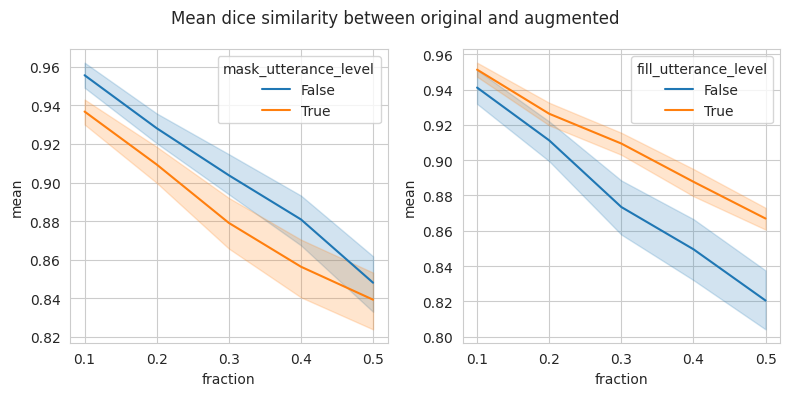

In [45]:
import seaborn as sns
import matplotlib.pyplot as plt
sns.set_style('whitegrid')

fig, ax = plt.subplots(1, 2, figsize=(8, 4))
sns.lineplot(data=df, x='fraction', y='mean', hue='mask_utterance_level', ax=ax[0])
sns.lineplot(data=df, x='fraction', y='mean', hue='fill_utterance_level', ax=ax[1])
fig.suptitle('Mean dice similarity between original and augmented')
fig.tight_layout()

результаты подтверждают следующие гипотезы:
- маскирование на уровне уттерансов сильнее меняет диалог
- заполнение масок на уровне уттерансов меньше меняет диалог

### Score Threshold

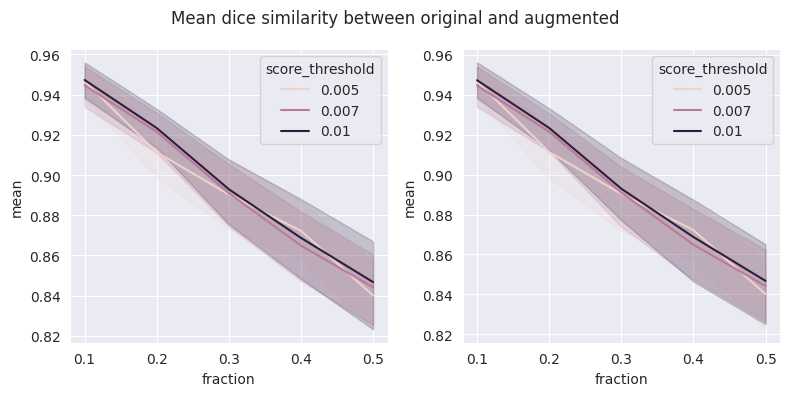

In [49]:
sns.set_style('darkgrid')
fig, ax = plt.subplots(1, 2, figsize=(8, 4))
sns.lineplot(data=df, x='fraction', y='mean', hue='score_threshold', ax=ax[0])
sns.lineplot(data=df, x='fraction', y='mean', hue='score_threshold', ax=ax[1])
fig.suptitle('Mean dice similarity between original and augmented')
fig.tight_layout()

эксперимент нужно повторить с другими значениями `score_threshold`

### topk vs greedy

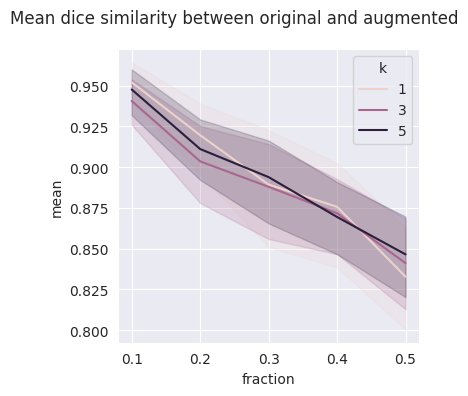

In [56]:
fig, ax = plt.subplots(1, 1, figsize=(4, 4))
mask = df['score_threshold'] == 0.005
sns.lineplot(data=df[mask], x='fraction', y='mean', hue='k', ax=ax)
fig.suptitle('Mean dice similarity between original and augmented')
fig.tight_layout()

неожиданный результат:
- жадный выбор существенно не отличается от topk
- скорее всего это связано с тем, что `score_threshold` слишком высок, нужно повторить этот эксперимент для `score_threshold=0`

поскольку жадный отбор быстрее (но это не точно, нужно повторить эксп), можно отказаться от topk 

пока что гипотеза следующая:
- лучше подобрать `score_threshold` --- это гарантирует валидность вставок
- а если нет возможности подобрать, то использовать `k>1`, это сгладит невалидность

### Fill Mask Model

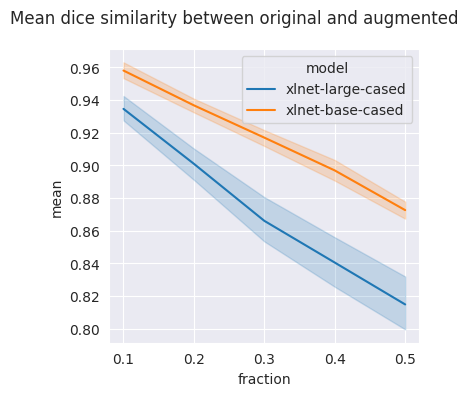

In [55]:
fig, ax = plt.subplots(1, 1, figsize=(4, 4))
sns.lineplot(data=df, x='fraction', y='mean', hue='model', ax=ax)
fig.suptitle('Mean dice similarity between original and augmented')
fig.tight_layout()

- неожиданный результат
- гипотеза: большая модель рассматривает более нетривиальные замены, которые одновременно более далёкие

## Big Exp BackTranslator

In [28]:
import optuna


def load_df(study_name):
    storage_name = f"sqlite:///{study_name}.db"
    study = optuna.create_study(study_name=study_name, storage=storage_name, load_if_exists=True)
    df = study.trials_dataframe()
    df = df.rename(columns={
        'values_0': 'mean_dice',
        'values_1': 'med_dice',
        'values_2': 'var_dice',
        'values_3': 'time',
        'values_4': 'edit_distance',
        'values_5': 'edit_similarity_ratio',
        'values_6': 'edit_similarity_jaro',
    })
    df.columns = df.columns.str.replace("params_", '')
    return df

In [30]:
df = load_df('back_translator')
df.head()

[I 2023-08-02 14:45:55,188] Using an existing study with name 'back_translator' instead of creating a new one.


,number,mean_dice,med_dice,var_dice,time,edit_distance,edit_similarity_ratio,edit_similarity_jaro,datetime_start,datetime_complete,duration,language,system_attrs_grid_id,system_attrs_search_space,state
0,0,0.842665,0.850000,0.009034,87.454412,5794.0,0.768093,0.778343,2023-08-02 03:57:36.182090,2023-08-02 03:59:04.993196,0 days 00:01:28.811106,hu,12,"{'language': ['ar', 'eu', 'bg', 'ca', 'cs', 'd...",COMPLETE
1,1,0.721681,0.730769,0.004911,82.570334,9484.0,0.577671,0.723543,2023-08-02 03:59:05.019734,2023-08-02 04:00:28.919609,0 days 00:01:23.899875,ml,16,"{'language': ['ar', 'eu', 'bg', 'ca', 'cs', 'd...",COMPLETE
2,2,0.839869,0.833333,0.006159,78.743492,6768.0,0.722904,0.773459,2023-08-02 04:00:28.943680,2023-08-02 04:01:48.909682,0 days 00:01:19.966002,uk,23,"{'language': ['ar', 'eu', 'bg', 'ca', 'cs', 'd...",COMPLETE
3,3,0.867810,0.875000,0.006459,82.725966,5189.0,0.791186,0.798123,2023-08-02 04:01:48.934559,2023-08-02 04:03:12.877335,0 days 00:01:23.942776,ar,0,"{'language': ['ar', 'eu', 'bg', 'ca', 'cs', 'd...",COMPLETE
4,4,0.883871,0.888889,0.005554,78.713538,4754.0,0.815696,0.795017,2023-08-02 04:03:12.903500,2023-08-02 04:04:32.864761,0 days 00:01:19.961261,cs,4,"{'language': ['ar', 'eu', 'bg', 'ca', 'cs', 'd...",COMPLETE


In [21]:
import seaborn as sns
import pandas as pd
sns.set_style('darkgrid')

def plot(df, x, y, x_lim=None, y_lim=None, shift=0):
    mask = (df[x] > 0) | (df[x] <= 0)
    if x_lim:
        mask = mask & (df[x] >= x_lim[0]) & (df[x] <= x_lim[1])
    if y_lim:
        mask = mask & (df[y] >= y_lim[0]) & (df[y] <= y_lim[1])
    df = df[mask]
    ax = sns.scatterplot(data=df, x=x, y=y)
    a = pd.concat({'x': df[x], 'y': df[y], 'val': df['language']}, axis=1)
    for i, point in a.iterrows():
        ax.text(point['x']+shift, point['y'], str(point['val']))

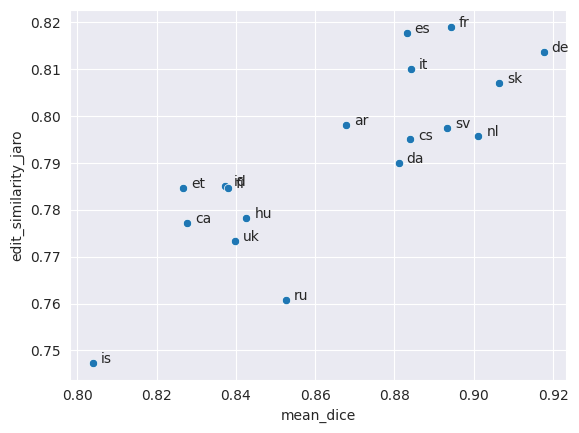

In [26]:
plot(df, 'mean_dice', 'edit_similarity_jaro', x_lim=[0.8,1], shift=0.002)

- стоит использовать переводы на `ru` и `is`

## Big Exp Replacer

In [52]:
df = load_df('replacer')
df.head()

[I 2023-08-02 15:04:53,617] Using an existing study with name 'replacer' instead of creating a new one.


,number,mean_dice,med_dice,var_dice,time,edit_distance,edit_similarity_ratio,edit_similarity_jaro,datetime_start,datetime_complete,duration,fill_utterance_level,k,model,system_attrs_grid_id,system_attrs_search_space,state
0,0,0.715841,0.750000,0.011354,68.161835,3894.0,0.821394,0.823346,2023-08-02 04:08:02.827773,2023-08-02 04:09:11.993562,0 days 00:01:09.165789,4,1,microsoft/mpnet-base,12,"{'fill_utterance_level': [True, 2, 3, 4], 'k':...",COMPLETE
1,1,0.693310,0.714286,0.016866,46.921820,4287.0,0.803414,0.824174,2023-08-02 04:09:12.002458,2023-08-02 04:09:59.560121,0 days 00:00:47.557663,2,3,microsoft/mpnet-base,5,"{'fill_utterance_level': [True, 2, 3, 4], 'k':...",COMPLETE
2,2,0.689152,0.687500,0.007288,35.213238,4157.0,0.809277,0.822606,2023-08-02 04:09:59.575157,2023-08-02 04:10:35.417210,0 days 00:00:35.842053,True,1,microsoft/mpnet-base,0,"{'fill_utterance_level': [True, 2, 3, 4], 'k':...",COMPLETE
3,3,0.708370,0.687500,0.008168,45.582151,4050.0,0.814272,0.822846,2023-08-02 04:10:35.426124,2023-08-02 04:11:21.632756,0 days 00:00:46.206632,2,1,microsoft/mpnet-base,4,"{'fill_utterance_level': [True, 2, 3, 4], 'k':...",COMPLETE
4,4,0.767512,0.750000,0.007432,66.046411,4146.0,0.810674,0.822400,2023-08-02 04:11:21.640971,2023-08-02 04:12:28.316277,0 days 00:01:06.675306,4,10,microsoft/mpnet-base,15,"{'fill_utterance_level': [True, 2, 3, 4], 'k':...",COMPLETE


### Context Size

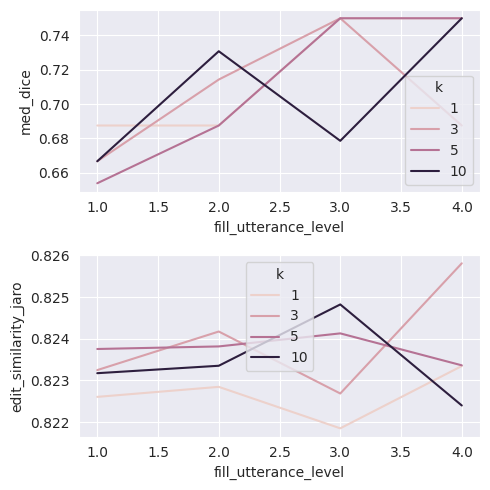

In [55]:
fig, ax = plt.subplots(2, 1, figsize=(5, 5))
sns.lineplot(df, x='fill_utterance_level', y='med_dice', hue='k', ax=ax[0])
sns.lineplot(df, x='fill_utterance_level', y='edit_similarity_jaro', hue='k', ax=ax[1])
fig.tight_layout()

- dice падает => тема диалога действительно сменилась
- edit similarity падает но не сильно

рецепт:
- использовать replacer с `fill_utterance_level=1или2` и `k=5`
- тогда будем получать нетривиальные отрицательные пары диалогов

### Time

<Axes: xlabel='fill_utterance_level', ylabel='time'>

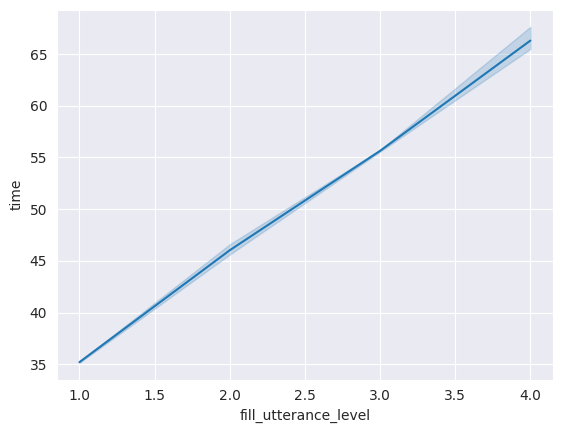

In [62]:
sns.lineplot(df, x='fill_utterance_level', y='time')

## Big Exp Inserter

In [63]:
df = load_df('inserter')
df.head()

[I 2023-08-02 15:08:19,861] Using an existing study with name 'inserter' instead of creating a new one.


,number,mean_dice,med_dice,var_dice,time,edit_distance,edit_similarity_ratio,edit_similarity_jaro,datetime_start,datetime_complete,duration,fill_utterance_level,fraction,k,mask_utterance_level,model,score_threshold,system_attrs_grid_id,system_attrs_search_space,state
0,0,0.916714,0.916667,0.006273,81.597543,6044.0,0.846638,0.756825,2023-08-02 04:25:10.004975,2023-08-02 04:26:32.603426,0 days 00:01:22.598451,4,0.3,10,True,microsoft/mpnet-base,0.013,559,"{'fill_utterance_level': [True, 2, 3, 4], 'fra...",COMPLETE
1,1,0.821295,0.857143,0.018378,183.287288,13335.0,0.714460,0.697274,2023-08-02 04:26:32.651172,2023-08-02 04:29:36.727088,0 days 00:03:04.075916,4,0.7,10,False,microsoft/mpnet-base,0.000,630,"{'fill_utterance_level': [True, 2, 3, 4], 'fra...",COMPLETE
2,2,0.943846,0.944444,0.003200,15.028107,1814.0,0.948437,0.812502,2023-08-02 04:29:36.774598,2023-08-02 04:29:52.518888,0 days 00:00:15.744290,2,0.1,10,False,microsoft/mpnet-base,0.005,192,"{'fill_utterance_level': [True, 2, 3, 4], 'fra...",COMPLETE
3,3,0.920866,0.916667,0.003977,57.587193,5793.0,0.852065,0.759338,2023-08-02 04:29:52.533216,2023-08-02 04:30:50.851542,0 days 00:00:58.318326,3,0.3,1,False,microsoft/mpnet-base,0.000,360,"{'fill_utterance_level': [True, 2, 3, 4], 'fra...",COMPLETE
4,4,0.946034,0.944444,0.002289,16.028829,2313.0,0.935172,0.804724,2023-08-02 04:30:50.867499,2023-08-02 04:31:07.618352,0 days 00:00:16.750853,True,0.1,1,True,microsoft/mpnet-base,0.013,9,"{'fill_utterance_level': [True, 2, 3, 4], 'fra...",COMPLETE


### Context Size

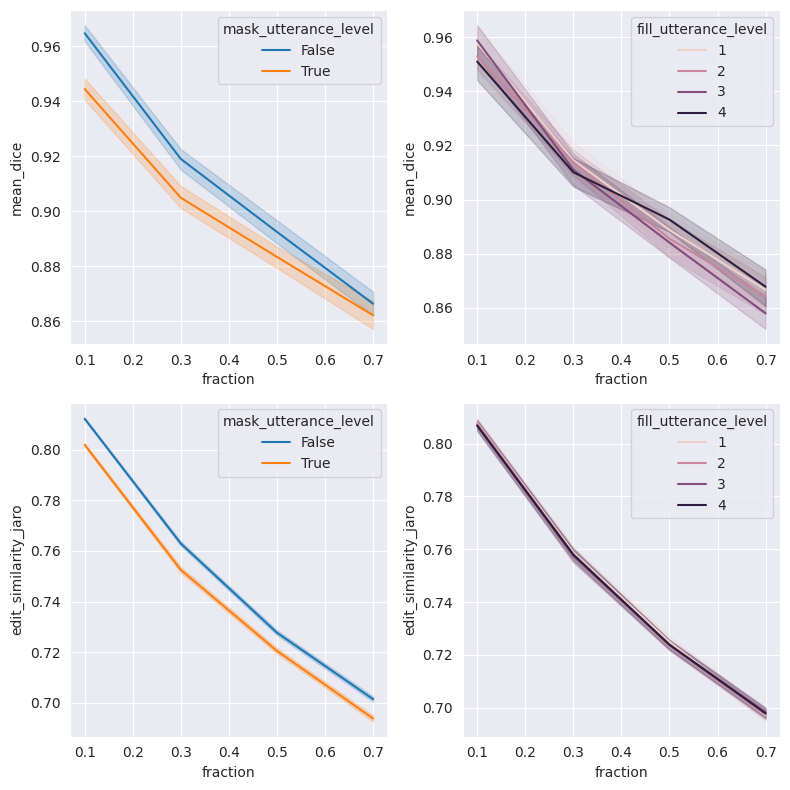

In [67]:
fig, ax = plt.subplots(2, 2, figsize=(8, 8))
sns.lineplot(data=df, x='fraction', y='mean_dice', hue='mask_utterance_level', ax=ax[0, 0])
sns.lineplot(data=df, x='fraction', y='mean_dice', hue='fill_utterance_level', ax=ax[0, 1])
sns.lineplot(data=df, x='fraction', y='edit_similarity_jaro', hue='mask_utterance_level', ax=ax[1, 0])
sns.lineplot(data=df, x='fraction', y='edit_similarity_jaro', hue='fill_utterance_level', ax=ax[1, 1])
fig.tight_layout()

### Score Threshold

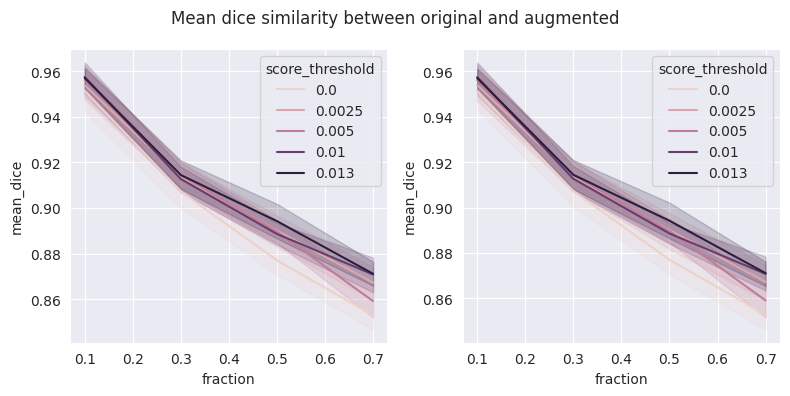

In [68]:
sns.set_style('darkgrid')
fig, ax = plt.subplots(1, 2, figsize=(8, 4))
sns.lineplot(data=df, x='fraction', y='mean_dice', hue='score_threshold', ax=ax[0])
sns.lineplot(data=df, x='fraction', y='mean_dice', hue='score_threshold', ax=ax[1])
fig.tight_layout()

### topk vs greedy

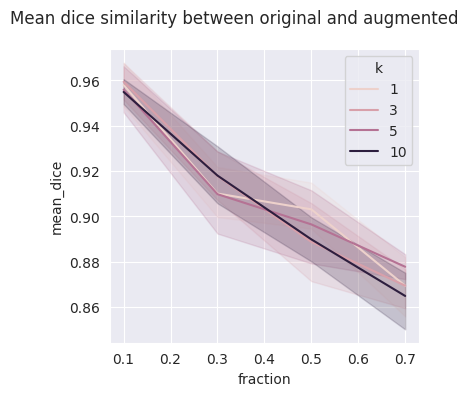

In [74]:
fig, ax = plt.subplots(1, 1, figsize=(4, 4))
mask = df['score_threshold'] == 0.013
sns.lineplot(data=df[mask], x='fraction', y='mean_dice', hue='k', ax=ax)
fig.suptitle('Mean dice similarity between original and augmented')
fig.tight_layout()

### time

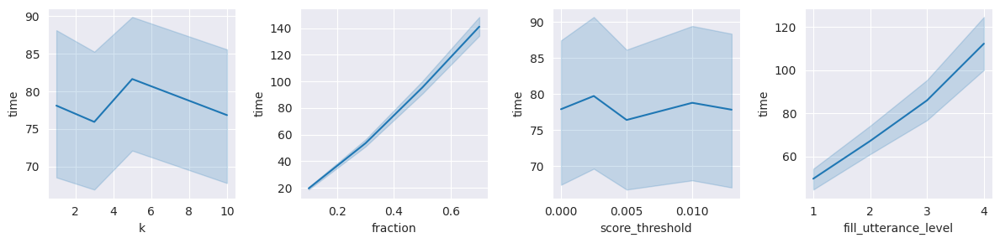

In [84]:
abscissas = ['k', 'fraction', 'score_threshold', 'fill_utterance_level']
n = len(abscissas)
fig, ax = plt.subplots(1, n, figsize=(n*3, 3))
for i, abs in enumerate(abscissas):
    sns.lineplot(df, x=abs, y='time', ax=ax[i])
fig.tight_layout()

## Make Demos

Подробные демки полученных аугментаций (генерит .md файлы)

In [ ]:
from my_augmentations import Inserter, Replacer, BackTranslator

In [2]:
inserter = Inserter(
    fraction=0.5,
    score_threshold=0.005,
    k=5,
    mask_utterance_level=True,
    fill_utterance_level=2,
    model='microsoft/mpnet-base',
    device='cuda'
)
inserter.from_file_system('inserter')

[nltk_data] Downloading package stopwords to /home/ilya/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [3]:
replacer = Replacer(
    k=3,
    fill_utterance_level=2,
    model='microsoft/mpnet-base',
    device='cuda'
)
replacer.from_file_system('replacer')

[nltk_data] Downloading package stopwords to /home/ilya/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [ ]:
back_translator = BackTranslator(
    language='ru',
    device='cuda'
)
back_translator.from_file_system('back_translator')

In [ ]:
from similarity_functions import count_vectorizer_from_sile_system as cv
from dgac_clustering import Clusters


cv(['inserter', 'replacer', 'back_translator'])

In [2]:
from visualization_utils import make_demo
from similarity_functions import dice

make_demo('inserter', dice)
make_demo('replacer', dice)
make_demo('back_translator', dice)

In [1]:
from visualization_utils import make_demo
from similarity_functions import dice

make_demo('listwise_shuffler', dice, view='two-sided', with_intent=False)

/home/alekseev_ilya/dialogue-augmentation/VENV/lib/python3.8/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
